In [2]:
# Connect google drive to google colab
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
# Incluya aquí todas las librería que utilice para el desarrollo
# import cv2
# import numpy as np
# import matplotlib.pyplot as plt
import cv2
import numpy as np
import imutils
from scipy.spatial import distance as dist
import os
import matplotlib
from matplotlib import pyplot as plt
from google.colab.patches import cv2_imshow
from skimage import feature
from skimage.io import imread, imshow
from skimage.transform import resize
from skimage.feature import hog
from skimage import exposure
from sklearn.decomposition import PCA
%matplotlib inline

In [ ]:
# Incluya aquí todas las librerías que necesite instalar adicionales
#!pip install xxxxx

In [4]:
main_datasets_path = '/content/drive/MyDrive/AVD/Trabajos_1_2/Datasets/'

In [4]:
# This will take some time (copy provided flowers dataset to Google Colab locally)
!cp -r /content/drive/MyDrive/AVD/Trabajos_1_2/Datasets/Dataset_Flores /content

# 1. Buscador de imágenes similares en base a descriptores de imagen
En esta tarea se va a desarrollar un buscador de imágenes similares. En este caso se proporciona un dataset de flores con 17 especies diferentes y numerosas imágenes de cada especie. La tarea se fundamenta en el empleo de descriptores de imagen para extracción de características de las imágenes con el fin de crear una serie de vectores que permitan realizar una búsqueda efectiva de imágenes similares. Junto al dataset se proprociona además otra carpeta con imágenes que se usarán como "queries" para la solución desarrollada.

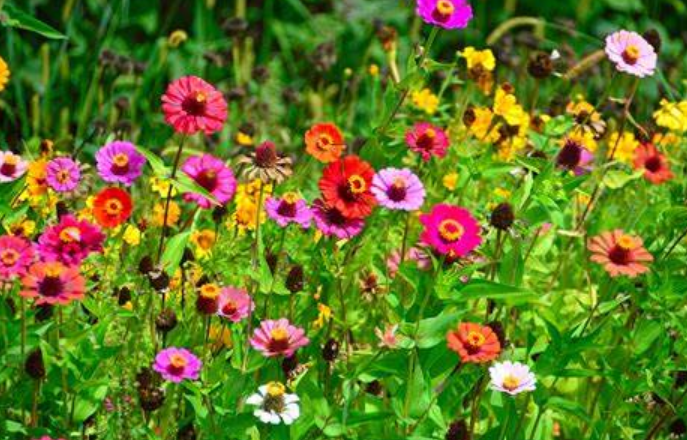

La primera parte tratará de seleccionar los algoritmos o técnicas que nos permitan crear estas representaciones vectoriales de las imágenes. Seguidamente se realizará un análisis exhaustivo y visualización de las características de cara a estudiar la efectividad de las técnicas seleccionadas. Una vez hecho esto se realizarán diferentes experimentos para realizar la búsqueda, estos experimentos servirán para demostrar que técnicas son más efectivas en este caso, que sucede dependiendo de los vectores empleados y que pasaría si combinamos varias características extraídas con diferentes algoritmos en la búsqueda.

## Análisis exploratorio de datos
En primer lugar se va a comenzar con un análisis exploratorio de datos de cara a entender el dataset proprocionado, el número de imágenes por especie, el tamaño de las imágenes entre otras características generales que se puedan analizar previo al análisis en sí de las imágenes mediante técnicas y algoritmos aplicados sobre ellas.

In [43]:
path_to_flowers_dataset = "Dataset_Flores"
carpetas = os.listdir(path_to_flowers_dataset)


In [ ]:
# Carpetas y número de imagenes por carpeta
print("Número de especies:", len(carpetas))
contador_2 = 0
for carpeta in carpetas:
  contador = 0
  x = os.listdir(path_to_flowers_dataset + "/" + carpeta)
  for imagen in x:
    contador += 1
    contador_2 += 1
  print(carpeta, ":", contador)

print("El número total de imágenes es:", contador_2)

Número de especies: 17
Lilyvalley : 79
Daffodil : 79
Coltsfoot : 79
Crocus : 79
Fritillary : 79
Snowdrop : 79
Buttercup : 79
Windflower : 79
Iris : 80
Tulip : 79
Tigerlily : 79
Sunflower : 79
Pansy : 79
Cowslip : 79
Dandelion : 79
Bluebell : 79
Daisy : 79
El número total de imágenes es: 1344


In [ ]:
#Tamaño de las imágenes
heights, widths, dims = [], [], []
for carpeta in carpetas:
  x = os.listdir(path_to_flowers_dataset + "/" + carpeta)
  for img in x:
    foto = cv2.imread(path_to_flowers_dataset + "/" + carpeta + "/" + img)
    heights.append(foto.shape[0])
    widths.append(foto.shape[1])
    dims.append(foto.shape[2])

hxw_unique = []
hxw = []
for i in range(len(heights)):
  hxw.append([heights[i], widths[i]])
  if [heights[i], widths[i]] not in hxw_unique:
    hxw_unique.append([heights[i], widths[i]])

values_h, counts_h = np.unique(heights, return_counts=True)
moda_h = values_h[counts_h == np.max(counts_h)]

values_w, counts_w = np.unique(widths, return_counts=True)
moda_w = values_w[counts_w == np.max(counts_w)]

values_hxw, counts_hxw = np.unique(hxw, axis = 0, return_counts=True)
moda_hxw, maximo = values_hxw[counts_hxw == np.max(counts_hxw)], np.max(counts_hxw)

print("Todas las imágenes tienen dimensión:", set(dims), "\nAlturas diferentes:", len(set(heights)), "  Intervalo: (",
      np.min(heights), np.max(heights), ")  Media:", np.mean(np.array(heights)), "  Moda:", moda_h, "  N_reps:",
      counts_h[values_h == moda_h], "\nAnchuras diferentes:", len(set(widths)), "  Intervalo: (", np.min(widths), ",",
      np.max(widths), ")  Media:", np.mean(np.array(widths)), "  Moda:", moda_w, "  N_reps:", counts_w[values_w == moda_w],
      "\nCombinaciones diferentes:", len(hxw_unique), "  Moda:", moda_hxw, "  N_reps:", maximo)

Todas las imágenes tienen dimensión: {3} 
Alturas diferentes: 211   Intervalo: ( 499 1093 )  Media: 555.7931547619048   Moda: [500]   N_reps: [787] 
Anchuras diferentes: 216   Intervalo: ( 499 , 1057 )  Media: 583.5863095238095   Moda: [500]   N_reps: [507] 
Combinaciones diferentes: 481   Moda: [[500 666]]   N_reps: 257


Hemos visto el número de carpetas y el número de imágenes por carpeta. También, los tamaños de las imágenes. Nos fijamos en que el valor más repetido de lejos tanto en alto como en ancho es 500, por lo que adaptaremos el tamaño de las imágenes a 500x500 en el análisis posterior

## Aplicación de descriptores de imagen
Dado el caracter del dataset, numerosos descriptores pueden ser empleados para el análisis de las imágenes. En este caso nos vamos a centrar en tres casos específicos.

- Color: Histograma RGB
- Forma: Histograma de gradientes orientados (HOG)
- Textura: Patrones binarios locales (LBP)

Se puede ver claramente que analizar el color de las imágenes es fundamental para realizar un búscado con estas imágenes de flores. Para ello se extraerá el histograma de color RGB y se comparará entre diferentes especies de flores para ver si es representativo y que ventajas o inconvenientes presenta. En segundo lugar, se observa que dependiendo del tipo de flor la forma (pétalos, hojas...) es algo bastante representativo de cada una de ellas. Por tanto, se empleará el algoritmo HoG para extraer un representación vectorial de la forma de las flores para poder diferenciar entre ellas en base a esta característica. Finalmente, la textura puede ser otro descriptor que ayude a la búsqueda pues algunas flores presentan pétalos más rugosos o semillas en el centro entre otras diferencias que pueden ser analizadas mediante esta característica empleado, por ejemplo, el algoritmo LBP.

Por tanto para este apartado se pide que selecciones al menos 5 especies lo más diferentes posibles entre ellas y analice una imagen de cada una de ellas mediante la aplicación de las tres técnicas presentadas anteriormente. Se pide que se represente todo lo posible d emanera visual y se detallen las explicaciones y conclusiones que extraiga de sus resultados. Justifique los parámetros empleados en cada uno de los algoritmos y porqué los ha seleccionado de esa manera.

In [ ]:
# load the image and show it
#images = ["/Tulip/image_0639.jpg", "/Tulip/image_0638.jpg", "/Tulip/image_0637.jpg", "/Tulip/image_0636.jpg", "/Tulip/image_0635.jpg", "/Tulip/image_0634.jpg", "/Tulip/image_0633.jpg", "/Tulip/image_0632.jpg", "/Tulip/image_0631.jpg"]
#images = ["/Pansy/image_1360.jpg", "/Pansy/image_1359.jpg", "/Pansy/image_1358.jpg", "/Pansy/image_1357.jpg", "/Pansy/image_1356.jpg", "/Pansy/image_1355.jpg", "/Pansy/image_1354.jpg", "/Pansy/image_1353.jpg", "/Pansy/image_1352.jpg"]
#images = ["/Lilyvalley/image_0239.jpg", "/Lilyvalley/image_0238.jpg", "/Lilyvalley/image_0237.jpg", "/Lilyvalley/image_0236.jpg", "/Lilyvalley/image_0235.jpg", "/Lilyvalley/image_0234.jpg", "/Lilyvalley/image_0233.jpg", "/Lilyvalley/image_0232.jpg", "/Lilyvalley/image_0231.jpg"]
#images = ["/Buttercup/image_1200.jpg", "/Buttercup/image_1199.jpg", "/Buttercup/image_1198.jpg", "/Buttercup/image_1197.jpg", "/Buttercup/image_1196.jpg", "/Buttercup/image_1195.jpg", "/Buttercup/image_1194.jpg", "/Buttercup/image_1193.jpg", "/Buttercup/image_1192.jpg"]
#images = ["/Fritillary/image_0719.jpg", "/Fritillary/image_0718.jpg", "/Fritillary/image_0717.jpg", "/Fritillary/image_0716.jpg", "/Fritillary/image_0715.jpg", "/Fritillary/image_0714.jpg", "/Fritillary/image_0713.jpg", "/Fritillary/image_0712.jpg", "/Fritillary/image_0711.jpg"]

images = ["/Tulip/image_0638.jpg", "/Pansy/image_1355.jpg", "/Lilyvalley/image_0234.jpg", "/Buttercup/image_1195.jpg", "/Fritillary/image_0717.jpg"]

Observamos imágenes de diferentes especies y seleccionamos una de cada especie, lo más diferente posible del resto y con rasgos diferenciables claros. Ahora, imprimiremos por pantalla los histogramas de color

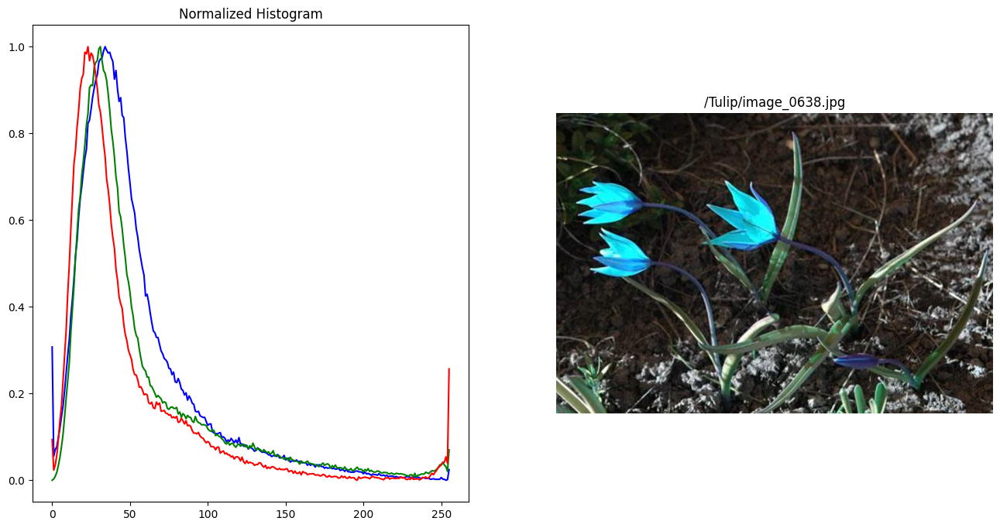

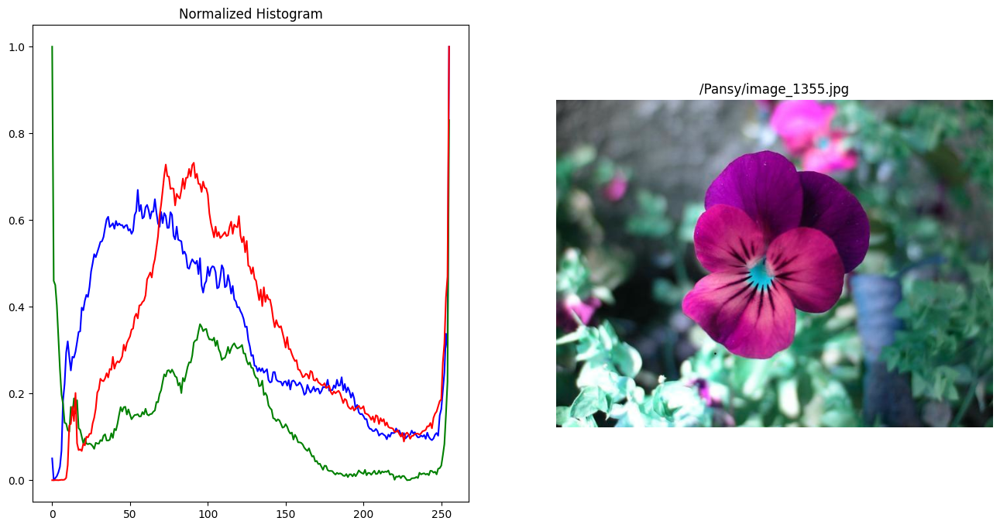

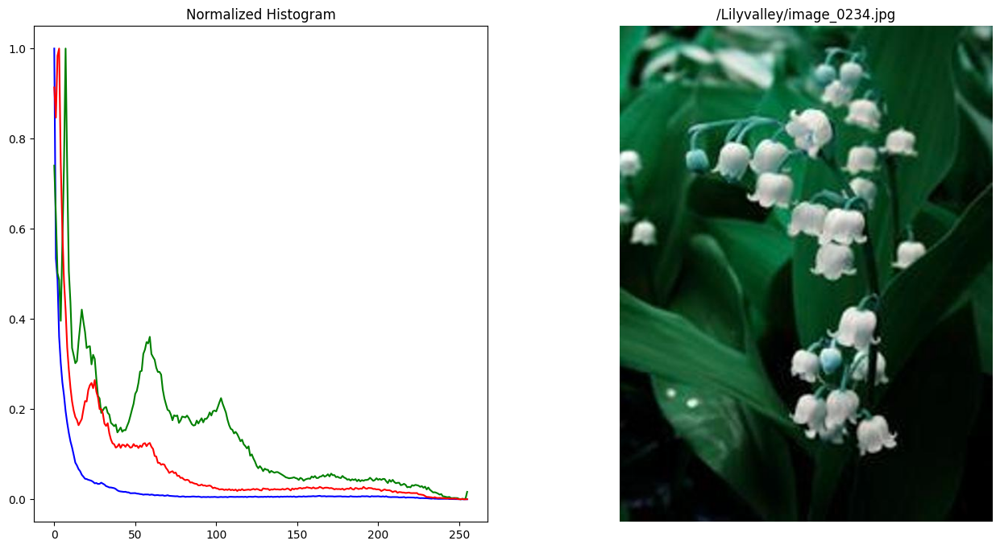

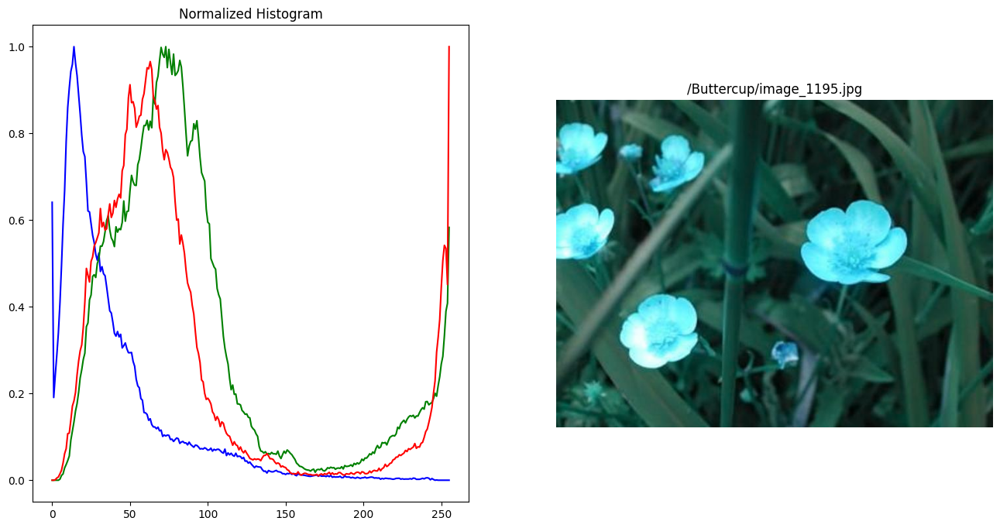

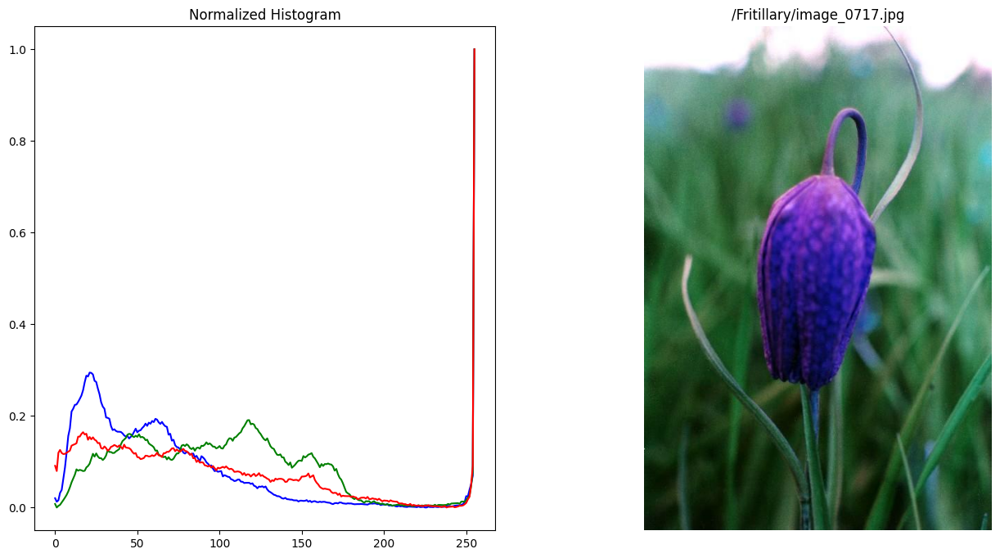

In [ ]:
for i in images:
    image = cv2.imread(path_to_flowers_dataset + i)
    color = ('b','g','r')
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

    for channel,col in enumerate(color):
      histr = cv2.calcHist([image],[channel],None,[256],[0,256])
      cv2.normalize(histr, histr, 0, 1, cv2.NORM_MINMAX)
      ax1.plot(histr,color = col)

    ax1.set_title('Normalized Histogram')

    ax2.imshow(image)
    ax2.set_title(i)


    plt.gca().set_axis_off()
    plt.show()


Observamos que el color dominante en los histogramas, en general, es el verde, puesto que los tallos y las hierbas de alrededor son de dicho color. A pesar de esto, creemos que el histograma de color será útil para diferenciar entre distintas especies de plantas (hay que tener en cuenta que muchas especies diferentes comparte un mismo color, eso sí). Seguimos con el Histogram Of Gradients-

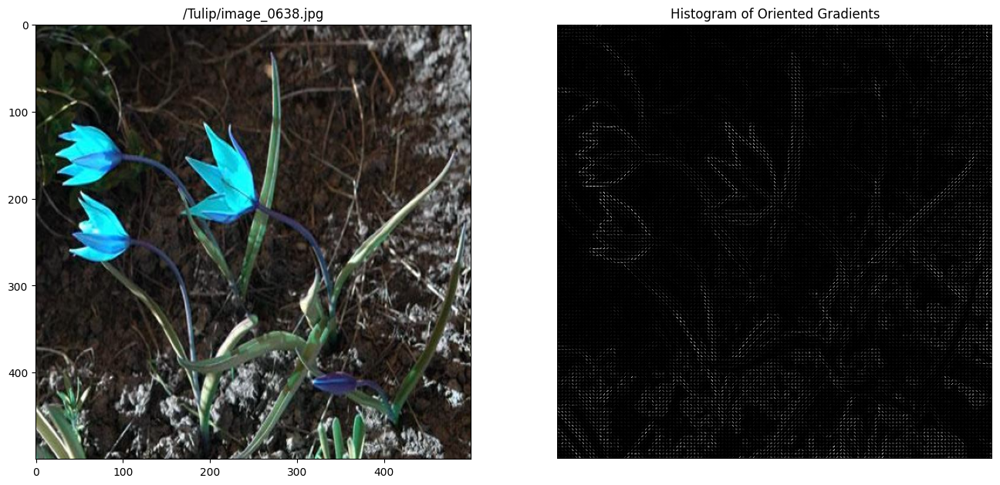

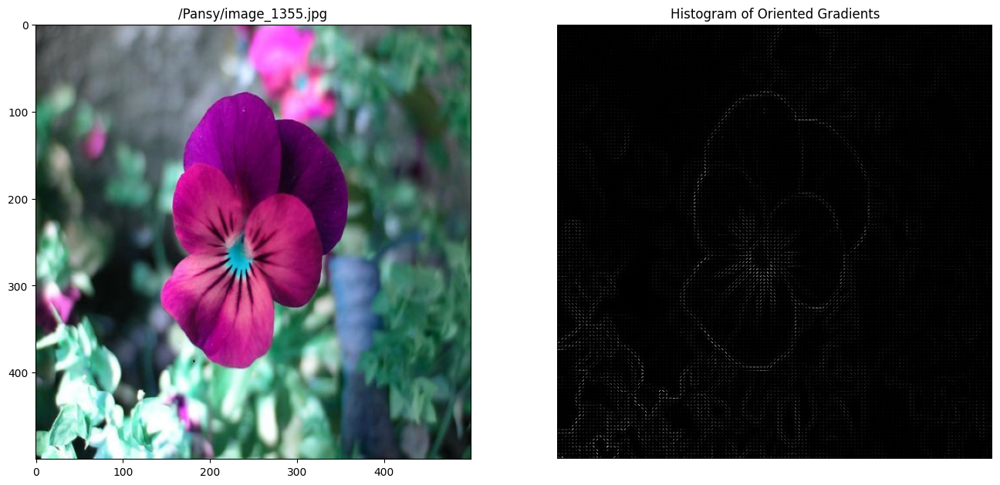

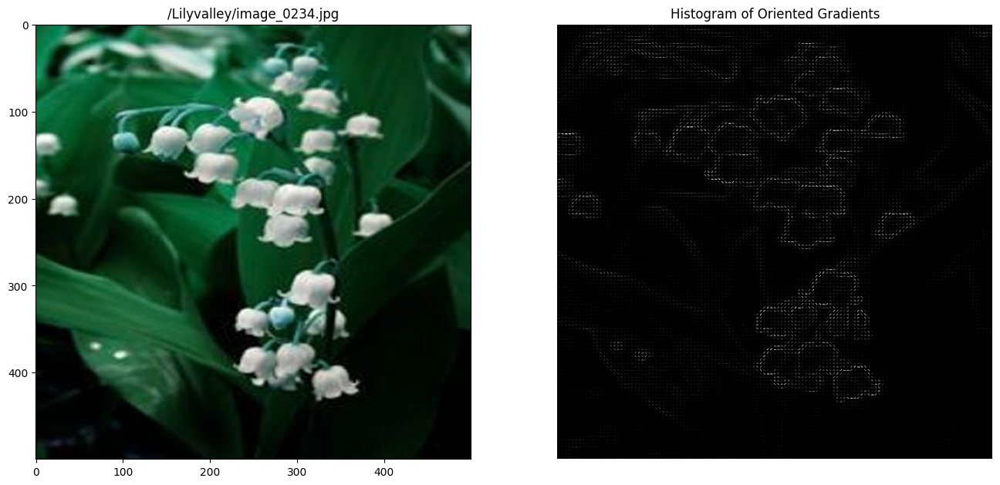

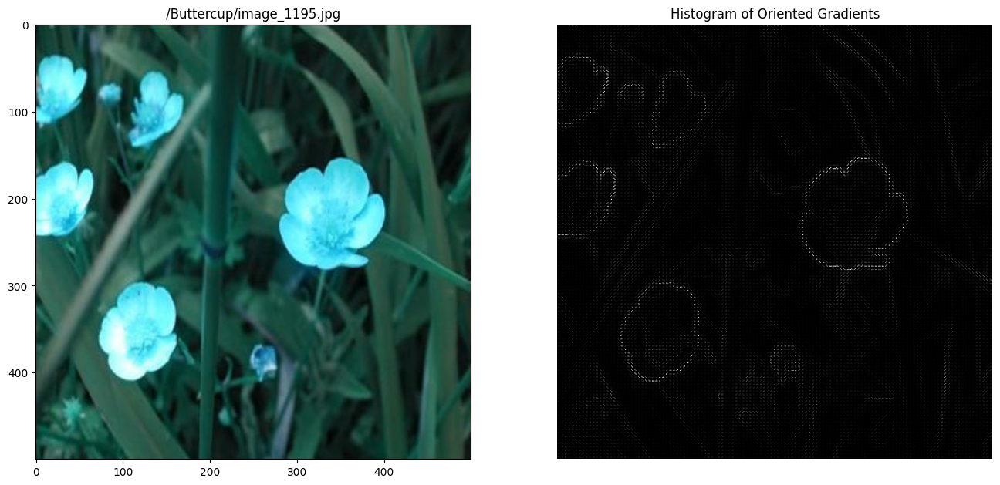

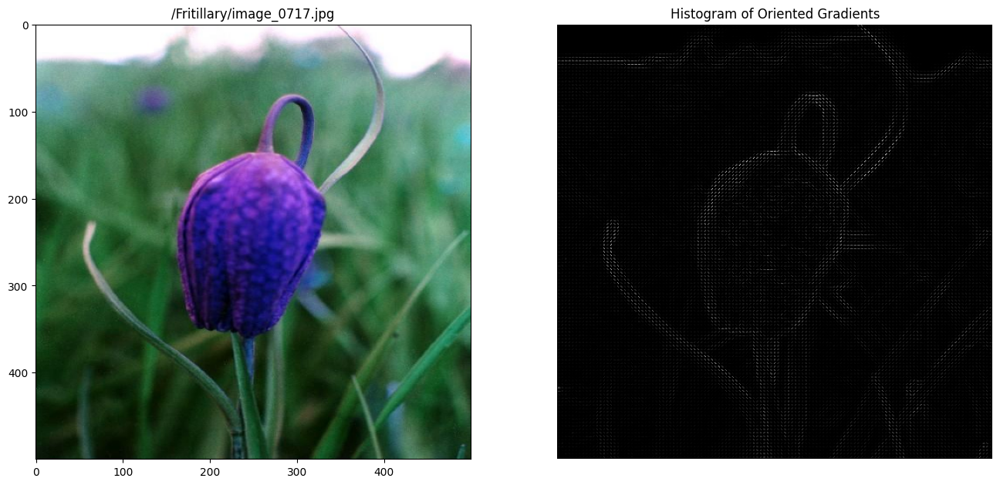

In [ ]:
for i in images:
  img = cv2.imread(path_to_flowers_dataset + i)
  resized_img = resize(img, (500,500))
  fd, hog_image = hog(resized_img, orientations=9, pixels_per_cell=(4, 4), cells_per_block=(2, 2), visualize=True, channel_axis=-1)
  fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))
  ax1.imshow(resized_img)
  ax1.set_title(i)

  hog_image_rescaled = exposure.rescale_intensity(hog_image, in_range=(0, 10))

  ax2.imshow(hog_image_rescaled, cmap=plt.cm.gray)
  ax2.set_title('Histogram of Oriented Gradients')
  plt.gca().set_axis_off()
  plt.show()

Después de probar con multitud de valores diferentes, nos hemos decantado por los que hay ahora, ya que las siluetas de las imágenes se observan nítidamente y parecen aportar bastante información. En apartados posteriores veremos sí esta ténica nos sirve para nuestro caso de estudio. Procedemos con el Local Binary Patterns

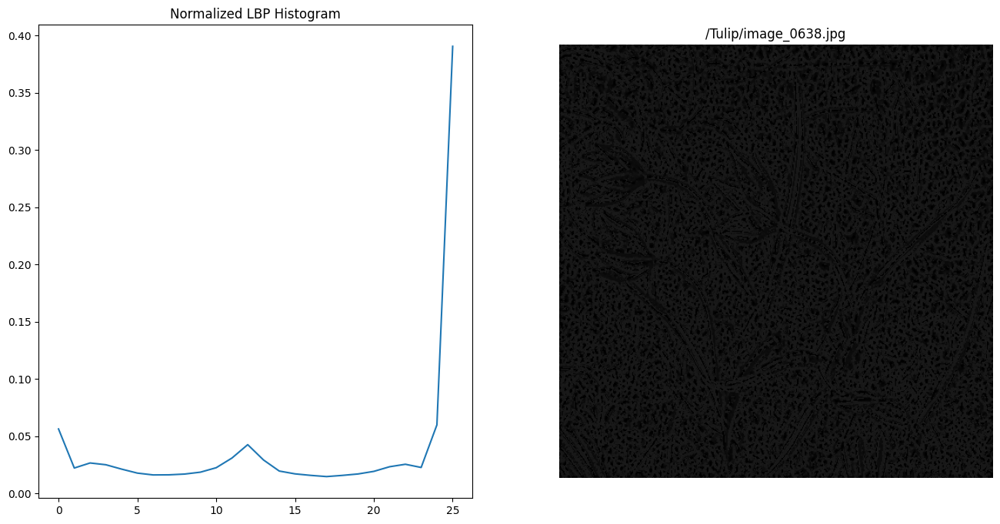

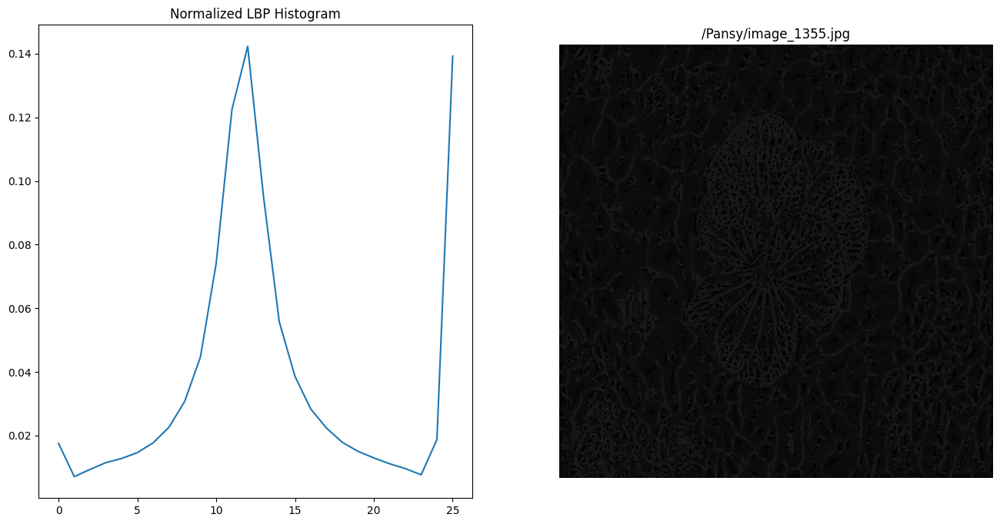

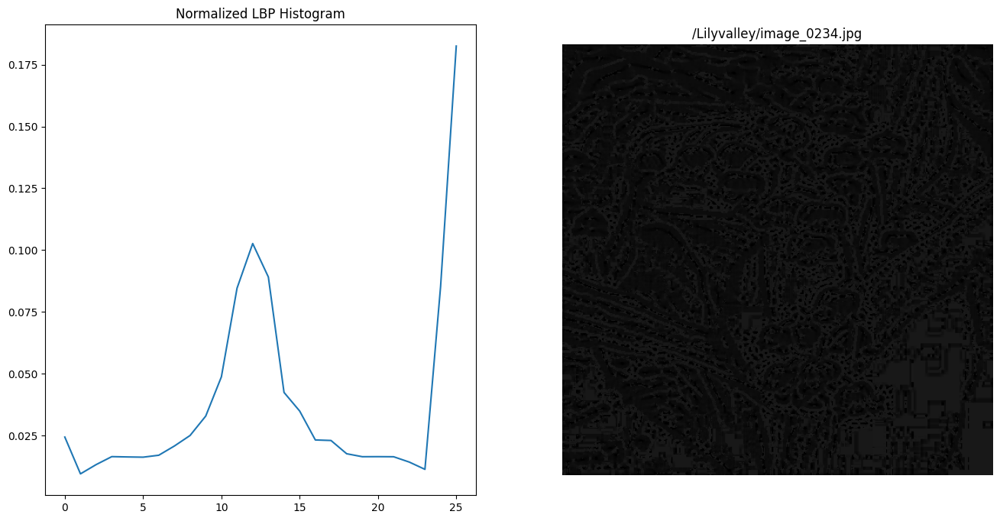

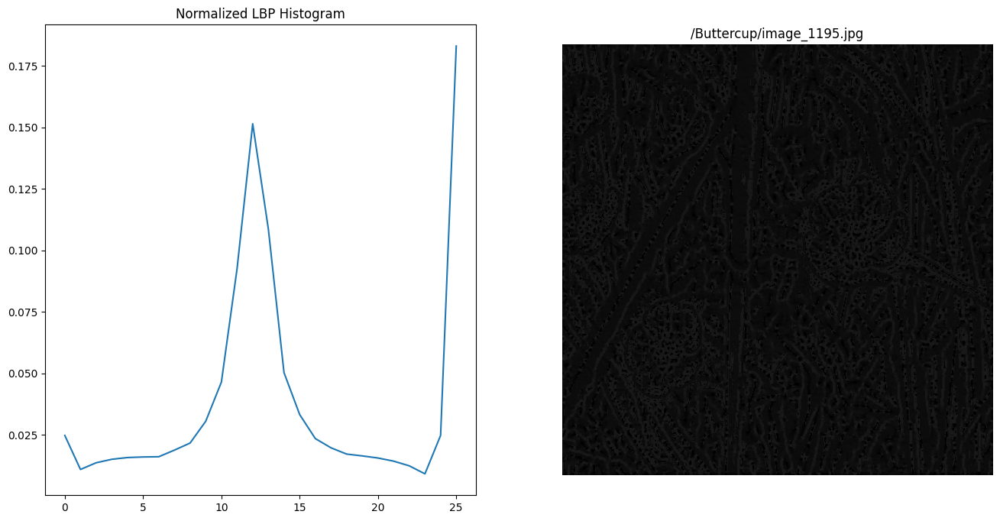

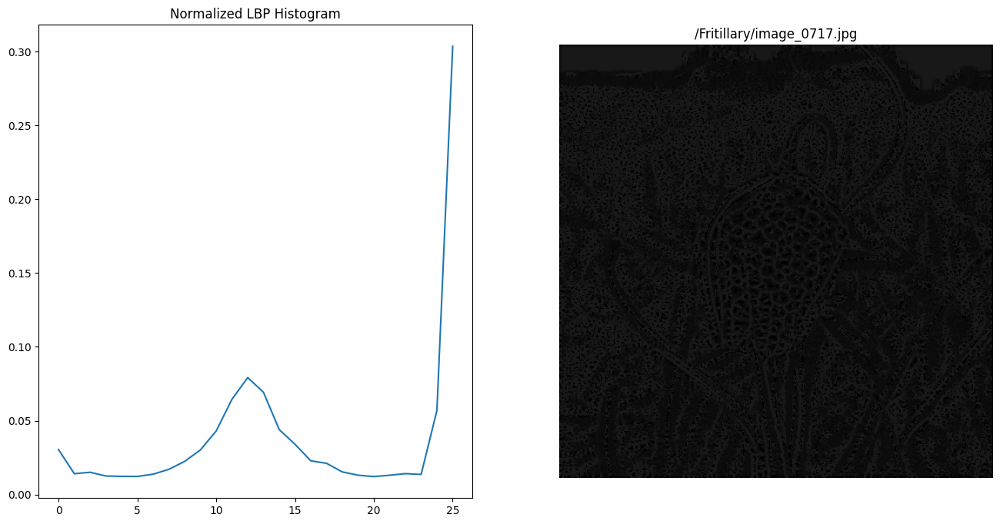

In [ ]:
for i in images:
  gray = cv2.imread(path_to_flowers_dataset + i, 0)
  resized_img = resize(gray, (500,500))
  # define the parameters of the Local Binary Patterns
  numPoints = 24
  radius = 3
  # extract the histogram of Local Binary Patterns
  lbp = feature.local_binary_pattern(resized_img, numPoints, radius, method="uniform")
  (hist, _) = np.histogram(lbp.ravel(), bins=range(0, numPoints + 3), range=(0, numPoints + 2))
  # optionally normalize the histogram
  eps = 1e-7
  hist = hist.astype("float")
  hist /= (hist.sum() + eps)
  fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

  ax2.imshow(cv2.cvtColor(lbp.astype("uint8"), cv2.COLOR_BGR2RGB))
  ax2.set_title(i)

  ax1.plot(hist)
  ax1.set_title('Normalized LBP Histogram')
  plt.gca().set_axis_off()
  plt.show()

Mismo caso que el Hog of Gradients, ajustamos los parámetros y el resultado parece satisfactorio. Probablemente, estas dos técnicas en combinación con los histogramas de color nos permiten diferenciar entre especies.

## Creación de la base de datos de vectores de características
Para realizar la búsqueda se va a crear una base de datos que almacene todos los vectores de características de todas las imágenes. Para esto puede emplear soluciones que se han visto durante las prácticas de la asignatura. Lo que interesa ahora es extraer de cada imagen el vector de características de cada una de las tres técnicas empleadas. Nota: Recuerde que para los algoritmos HoG y LBP las imágenes deben reescalarse a un tamaño similar sino los vectores de características tendrán tamaños diferentes. Por tanto, decida previamente el tamaño por defecto al que se reescalarán todas las imágenes.

In [ ]:
class RGBHistogram:
	def __init__(self, bins):
		# store the number of bins the histogram will use
		self.bins = bins

	def describe(self, image):
		# compute a 3D histogram in the RGB colorspace,
		# then normalize the histogram so that images
		# with the same content, but either scaled larger
		# or smaller will have (roughly) the same histogram
		hist = cv2.calcHist([image], [0, 1, 2],
			None, self.bins, [0, 256, 0, 256, 0, 256])
		hist = cv2.normalize(hist,hist)

		# return out 3D histogram as a flattened array
		return hist.flatten()

def get_hog_features(image):
  image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
  resized_img = resize(image, (500,500))
  fd, hog_image = hog(resized_img, orientations=9, pixels_per_cell=(4, 4), cells_per_block=(2, 2), visualize=True, channel_axis=-1)
  return fd

def get_color_histograms(image):
  image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
  features = histogram.describe(image)
  return features

def get_lbp_histogram(path):

  gray = cv2.imread(path, 0)
  resized_img = resize(gray, (500,500))
  numPoints, radius = 24, 3
  lbp = feature.local_binary_pattern(resized_img, numPoints, radius, method="uniform")
  (hist, _) = np.histogram(lbp.ravel(), bins=range(0, numPoints + 3), range=(0, numPoints + 2))
  eps = 1e-7
  hist = hist.astype("float")
  hist /= (hist.sum() + eps)
  return hist

In [ ]:
features_vectors = []
especies = os.listdir(path_to_flowers_dataset)

for especie in especies:
  carpeta = os.listdir(path_to_flowers_dataset + "/" + especie)
  for foto in carpeta:
    path = str(path_to_flowers_dataset + "/" + especie+ "/" + foto)
    image = cv2.imread(path)
    training_data = {}
    training_data['hog_features'] = get_hog_features(image)
    training_data['color_histograms'] = get_color_histograms(image)
    training_data['lbp_histogram'] = get_lbp_histogram(path)
    training_data['image_specie'] = especie
    training_data['path'] = foto

  features_vectors.append(training_data)

len(features_vectors)

17

Hemos definido una lista, donde guardaremos los vectores de características. Para cada imagen obtenemos aquellas características relativas a las tres técnicas utilizadas anteriormente. Además guardamos la información de cada imagen en un diccionario, es decir, nuestro vector es una lista de diccionarios.

## Desarrollo de la solución de búsqueda
Ahora debe desarrollar la solución que permita la búsqueda en la base de datos mediante una imágen "query" que se comparará con todas las de la base de datos. Para ello debe realizar la comparación del vector de características que desee emplear de la imagen query con el vector de características del mismo tipo de todas las imágenes de la base de datos. Para esto puede emplear por ejemplo una métrica de distancia de las más conocidas como la distancia euclídea, distancia del coseno, entre otras. Devuelva al menos los 10 primeros resultados más similares. Nota: Puede emplear las soluciones ya presentadas en algunas de las prácticas de la asignatura. Tenga en cuenta que se debe poder seleccionar que vector de características (Histograma RGB, HoG, LBP) se va a emplear para la comparación e incluso pueden usarser combinaciones de estos (Histograma RGB + LBP, Histograma RGB + HoG, HoG + LBP, Histograma RGB + LBP + HoG).

Para realizar la busqueda definimos una función que recibe como parámetros la imagen por la que queremos "buscar", los vectores de características recopilados en el anterior paso, la característica que queremos utilizar para calcular las distancias (es decir RGB, HOG, LBP o una combinación de las mismas) y opcionalmente el número de resultados, siendo 10 el número por defecto.

Una vez dentro de la función, esta calcula la distancia entre cada uno de los vectores de características obtenidos en el paso anterior (todas las fotos) y la característica definida para la foto de la query. Al finalizar el bucle, ordenamos el resultado (la métrica de distancia utilizada ha sido la normal euclidea), seleccionando aquellas imágenes que menos se distanciaron de la query.

In [ ]:
def search(query, database, feature_query, n_results=10):
  results = {}

  for vector in database:
    if feature_query == "RGB":
      image = cv2.imread(query)
      features = get_color_histograms(image)
      d = np.linalg.norm(vector['color_histograms'] - features)
    elif feature_query == "HOG":
      image = cv2.imread(query)
      features = get_hog_features(image)
      d = np.linalg.norm(vector["hog_features"] - features)

    elif feature_query == "LBP":
      features = get_lbp_histogram(query)
      d = np.linalg.norm(vector['lbp_histogram'] - features)

    elif feature_query == "RGB + HOG":
      image = cv2.imread(query)
      features = get_hog_features(image)
      features_2 = get_color_histograms(image)
      d = np.linalg.norm(vector["hog_features"] - features) + np.linalg.norm(vector['color_histograms'] - features_2)

    elif feature_query == "RGB + LBP":
      image = cv2.imread(query)
      features = get_lbp_histogram(query)
      features_2 = get_color_histograms(image)
      d = np.linalg.norm(vector["lbp_histogram"] - features) + np.linalg.norm(vector['color_histograms'] - features_2)

    elif feature_query == "HOG + LBP":
      image = cv2.imread(query)
      features = get_lbp_histogram(query)
      features_2 = get_hog_features(image)
      d = np.linalg.norm(vector["lbp_histogram"] - features) + np.linalg.norm(vector['hog_features'] - features_2)

    elif feature_query == "RGB + HOG + LBP":
      image = cv2.imread(query)
      features = get_lbp_histogram(query)
      features_2 = get_color_histograms(image)
      features_3 = get_hog_features(image)
      d = np.linalg.norm(vector["lbp_histogram"] - features) + np.linalg.norm(vector['color_histograms'] - features_2) + np.linalg.norm(vector['hog_features'] - features_3)
    else:
      raise ValueError("Argument not valid")
    id = vector["path"]
    results[id] = d
  results = {k: v for k, v in sorted(results.items(), key=lambda item: item[1])}
  return list(results.keys())[:n_results]


Y para enseñar los resultados definimos una simple función:

In [ ]:
def show_results(query, results, species, species_path, n_results = 10):
    plt.figure(figsize=(20, n_results))
    plt.subplot(1, 11, 1)
    plt.axis('off')
    q = cv2.imread(query)
    plt.imshow(cv2.cvtColor(q, cv2.COLOR_BGR2RGB))
    plt.title('Query')
    for i, result in enumerate(results):
        for specie in species:
            ruta=species_path+specie
            image_files = [file for file in os.listdir(ruta)]
            if result in image_files:
                image_path = os.path.join(ruta, result)
                image = cv2.imread(image_path)
                plt.subplot(1, 11, i+2)
                plt.axis('off')
                plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
                plt.title(specie)
                break

## Análisis de resultados
Realice varias búsquedas para probar su solución con las imágenes "query" que se proprocionan en la carpeta adicional. Pruebe a realizar búsquedas con cada vector de caracterísitcas extraído con cada técnica y con combinaciones de estos. Comente los resultados obtenidos en detalle, si cumplen las espectativas y que sucede con cada vector de características.

['image_1012.jpg', 'image_0311.jpg', 'image_0325.jpg', 'image_1321.jpg', 'image_0237.jpg', 'image_0143.jpg', 'image_0450.jpg', 'image_0824.jpg', 'image_0582.jpg', 'image_1280.jpg']


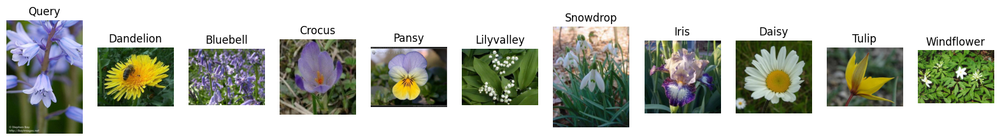

In [ ]:
query_path = main_datasets_path + 'Flores_Query/'
image_files = query_path + 'Bluebell/'
fotos = os.listdir(image_files)
query = image_files + fotos[0]

results = search(query, features_vectors, "RGB")
print(results)
array = os.listdir(main_datasets_path + path_to_flowers_dataset + "/")
show_results(query, results, array, main_datasets_path + path_to_flowers_dataset + "/" )

Comenzamos con resultados decepcionantes para Bluebell, tanto con HOG como con LBP y RGB. Parece que nuestros vectores de características no son suficientes para generar un motor de busqueda fiable.

['image_0012.jpg', 'image_0237.jpg', 'image_0450.jpg', 'image_1012.jpg', 'image_1061.jpg', 'image_0502.jpg', 'image_0893.jpg', 'image_0675.jpg', 'image_0824.jpg', 'image_0311.jpg']


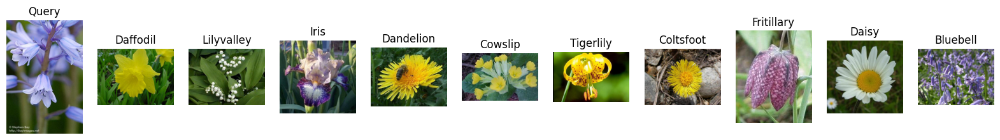

In [ ]:
query_path = main_datasets_path + 'Flores_Query/'
image_files = query_path + 'Bluebell/'
fotos = os.listdir(image_files)
query = image_files + fotos[0]

results = search(query, features_vectors, "LBP")
print(results)
array = os.listdir(main_datasets_path + path_to_flowers_dataset + "/")
show_results(query, results, array, main_datasets_path + path_to_flowers_dataset + "/" )

['image_1321.jpg', 'image_0734.jpg', 'image_1280.jpg', 'image_0675.jpg', 'image_1143.jpg', 'image_1012.jpg', 'image_0893.jpg', 'image_0237.jpg', 'image_0582.jpg', 'image_0325.jpg']


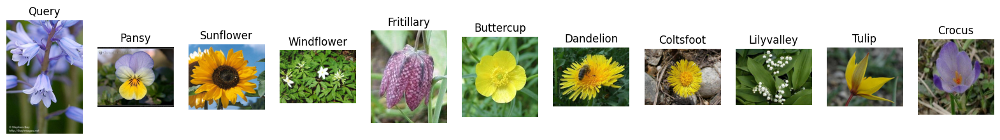

In [ ]:
query_path = main_datasets_path + 'Flores_Query/'
image_files = query_path + 'Bluebell/'
fotos = os.listdir(image_files)
query = image_files + fotos[0]

results = search(query, features_vectors, "HOG")
print(results)
array = os.listdir(main_datasets_path + path_to_flowers_dataset + "/")
show_results(query, results, array, main_datasets_path + path_to_flowers_dataset + "/" )

['image_1012.jpg', 'image_0734.jpg', 'image_1321.jpg', 'image_1280.jpg', 'image_0893.jpg', 'image_0012.jpg', 'image_0824.jpg', 'image_1061.jpg', 'image_0237.jpg', 'image_0675.jpg']


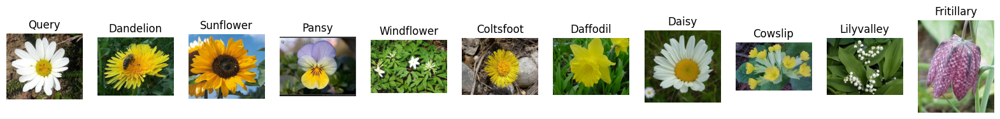

In [ ]:
query_path = main_datasets_path + 'Flores_Query/'
image_files = query_path + 'Daisy/'
fotos = os.listdir(image_files)
query = image_files + fotos[0]

results = search(query, features_vectors, "HOG")
print(results)
array = os.listdir(main_datasets_path + path_to_flowers_dataset + "/")
show_results(query, results, array, main_datasets_path + path_to_flowers_dataset + "/" )

Aunque los resultados no son los deseados, vemos como el Histogram of Gradients funciona adecuadamente, puesto que todas las flores que nos devuelve la consulta se parecen en la forma a la margarita

['image_0734.jpg', 'image_1012.jpg', 'image_1321.jpg', 'image_0893.jpg', 'image_0824.jpg', 'image_1280.jpg', 'image_0237.jpg', 'image_1061.jpg', 'image_0012.jpg', 'image_0502.jpg']


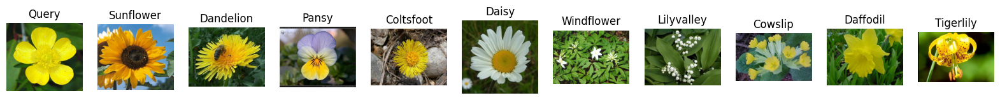

In [ ]:
query_path = main_datasets_path + 'Flores_Query/'
image_files = query_path + 'Buttercup/'
fotos = os.listdir(image_files)
query = image_files + fotos[0]

results = search(query, features_vectors, "HOG")
print(results)
array = os.listdir(main_datasets_path + path_to_flowers_dataset + "/")
show_results(query, results, array, main_datasets_path + path_to_flowers_dataset + "/" )

['image_0734.jpg', 'image_1321.jpg', 'image_1012.jpg', 'image_1280.jpg', 'image_0675.jpg', 'image_0824.jpg', 'image_0237.jpg', 'image_0012.jpg', 'image_0893.jpg', 'image_1143.jpg']


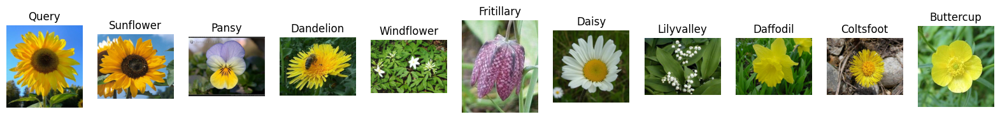

In [ ]:
query_path = main_datasets_path + 'Flores_Query/'
image_files = query_path + 'Sunflower/'
fotos = os.listdir(image_files)
query = image_files + fotos[0]

results = search(query, features_vectors, "RGB + HOG")
print(results)
array = os.listdir(main_datasets_path + path_to_flowers_dataset + "/")
show_results(query, results, array, main_datasets_path + path_to_flowers_dataset + "/" )

Parece que al combinar diferentes técnicas se obtiene un mejor resultado, aunque este siga siendo completamente insuficiente.

['image_0012.jpg', 'image_1280.jpg', 'image_1012.jpg', 'image_1321.jpg', 'image_1061.jpg', 'image_0734.jpg', 'image_0893.jpg', 'image_0450.jpg', 'image_0675.jpg', 'image_0824.jpg']


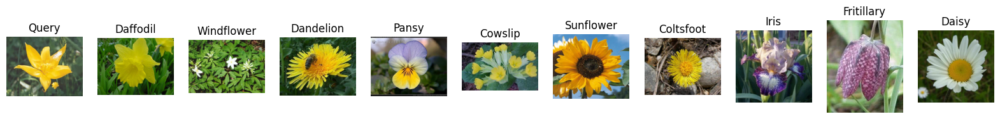

In [ ]:
query_path = main_datasets_path + 'Flores_Query/'
image_files = query_path + 'Tulip/'
fotos = os.listdir(image_files)
query = image_files + fotos[0]

results = search(query, features_vectors, "RGB + HOG + LBP")
print(results)
array = os.listdir(main_datasets_path + path_to_flowers_dataset + "/")
show_results(query, results, array, main_datasets_path + path_to_flowers_dataset + "/" )

Finalmente, en la última query volvemos a ver que los vectores de características no son suficientes para generar un motor de busqueda por imágenes.

# 2. Generación automática de descripción FEN en tableros de ajedrez

El objetivo de este proyecto es desarrollar un sistema que sea capaz de convertir una foto de una posición de ajedrez a un formato estructurado que pueda ser comprendido por motores de ajedrez, como la notación Forsyth-Edwards (FEN), ampliamente utilizada.

La notación Forsyth-Edwards (FEN) es un método estándar para describir una posición particular en un juego de ajedrez. Es útil para registrar juegos o para configurar tableros de ajedrez en una posición específica. La notación FEN encapsula toda la información necesaria para continuar un juego desde un punto particular.

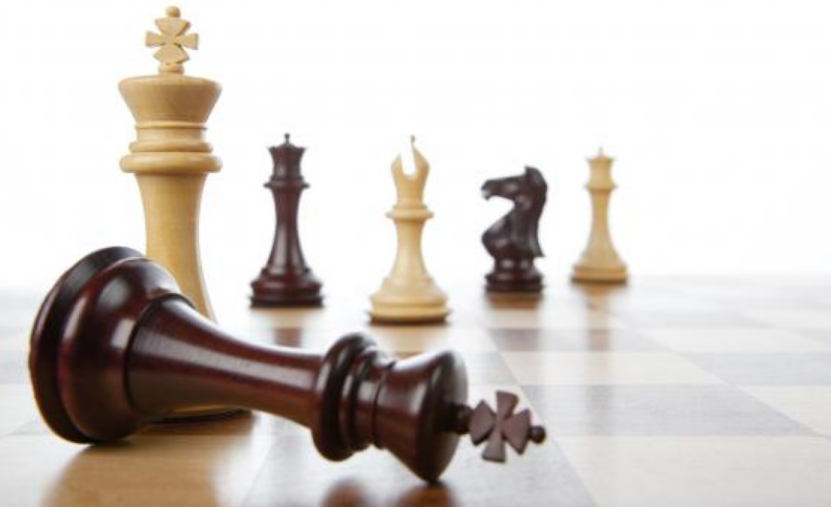

Un código FEN consta de seis campos separados por espacios. Aquí está lo que representa cada campo:

1. Posición de las Piezas: Describe la posición de las piezas en el tablero, empezando desde la octava fila (la fila más cercana al jugador negro) hasta la primera fila, con cada fila separada por '/'. Cada pieza se identifica por una letra. Las blancas usan letras mayúsculas ("K" para el rey, "Q" para la dama, "R" para las torres, "B" para los alfiles, "N" para los caballos, y "P" para los peones) y las negras usan minúsculas. Los espacios vacíos se denotan con dígitos del 1 al 8, que representan el número de casillas consecutivas vacías en esa fila.

2. Jugador Activo: Indica qué jugador mueve a continuación ("w" para las blancas, "b" para las negras).

3. Derechos de Enroque: Muestra los enroques disponibles. "K" indica que las blancas pueden hacer enroque corto, "Q" indica enroque largo de las blancas, "k" para el enroque corto de las negras y "q" para el largo. Si no hay posibilidad de enroque, se utiliza un guion ("-").

4. Al Paso: Indica si hay una oportunidad para capturar al paso. Esto se representa por la casilla en la que un peón podría ser capturado. Si no hay tal oportunidad, se utiliza un guion ("-").

5. Contador de Medio Movimiento: Este número cuenta los medios movimientos (cada movimiento de una pieza es un medio movimiento) desde la última captura o movimiento de peón. Este campo se utiliza para determinar si un juego puede ser declarado en tablas por la regla de los cincuenta movimientos.

6. Número de Movimiento: Cuenta los movimientos completos en el juego y se incrementa después de cada movimiento de las negras.

Por ejemplo, la posición inicial de un juego de ajedrez en notación FEN es:

rnbqkbnr/pppppppp/8/8/8/8/PPPPPPPP/RNBQKBNR w KQkq - 0 1

Este código FEN representa:

- La disposición estándar de las piezas al inicio del juego.
- Que las blancas (w) tienen el próximo movimiento.
- Ambos jugadores pueden enrocar de cualquier forma (KQkq).
- No hay capturas al paso posibles.
- El contador de medio movimiento es 0.
- El número de movimiento es 1.

Por ejemplo, la siguiente imagen representa una posición concreta de las piezas y su representación FEN es:

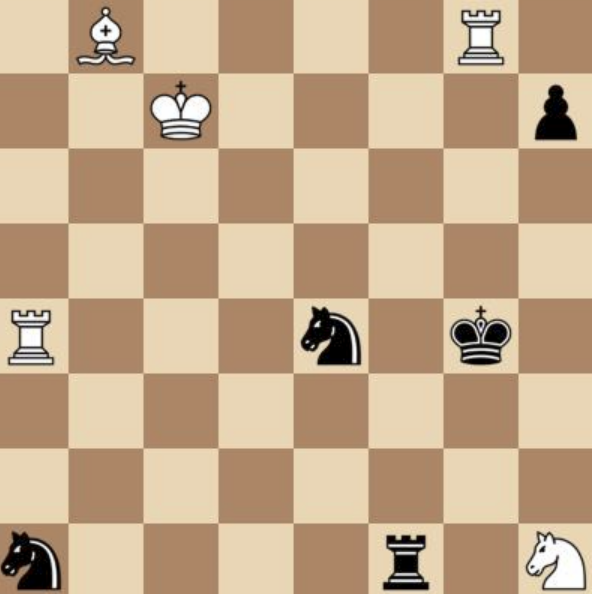![image-3.png](attachment:image-3.png)

<h1><center>1B4R1/2K4p/8/8/R3n1k1/8/8/n4r1N</center></h1>

Para esta actividad se va a obviar toda la información adicional que se codifica en esta representación y sólo nos vamos a centrar en extraer automáticamente la disposición inicial de las piezas al inicio del juego como se ha mostrado en el ejemplo anterior. Para resolver este problema vamos a utilizar lo métodos de extracción de características en imagen vistos en el curso para crear una aplicación que a partir de la imagen genere automáticamente esta notación.

Se proporcionan 5 imágenes de una disposición inicial de 5 partidas de ajedrez diferentes. Las imágenes son de tamaño 400x400. Además se proporcionan las imágenes relativas a cada una de las piezas, blancas y negras, de tamaño 50x50.

## Extracción de características
En este apartado debe aplicar las técnicas que considere oportunas sobre las diferentes piezas para extraer la información necesaria que se usará para comparar y clasificar la pieza. Tenga en cuenta que hay que diferencias no solo entre diferentes piezas sino además el color de la pieza. Extraiga los vectores de características de cada pieza y almcenelos para usarlos para la comparativa más adelante.

En primer lugar vemos las piezas de las que disponemos de ejemplo.

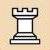

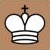

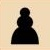

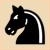

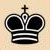

...

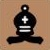

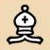

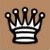

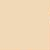

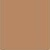

In [5]:
piezas_path = main_datasets_path + 'Piezas/'
piezas = os.listdir(piezas_path)
piezas_images_paths, piezas_images = [], []

for i in piezas:
  piezas_images_paths.append(piezas_path + i)
  image = cv2.imread(piezas_path + i)
  piezas_images.append(image)
  cv2_imshow(image)
  print('')

In [26]:
def get_hog_features(path):
  img = cv2.imread(path)
  image = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  fd, hog_image = hog(image, orientations=9, pixels_per_cell=(4, 4), cells_per_block=(2, 2), visualize=True, channel_axis=-1)
  return fd

chess_features_vectors = {}
for path in piezas_images_paths:
  image_byn = cv2.imread(path, cv2.IMREAD_GRAYSCALE)
  image_bw= np.dstack([image_byn, image_byn, image_byn])
  hist = cv2.calcHist([image_bw],[0],None,[256],[0,256])
  chess_features_vectors[path] = {"Hist": hist, "HOG": get_hog_features(path)}


Guardamos como características el HOG y el histograma en escala de grises, por las razones que explicaremos en el siguiente apartado.

## Análisis de las características
Ahora analice en profundidad las características extraídas mediante las representaciones que considere oportunas y describa en detalle si cree que pueden ser útiles para diferenciar entre las distintas piezas. Se pide un análisis exhaustivo.

En primer lugar analizamos los histogramas de color.

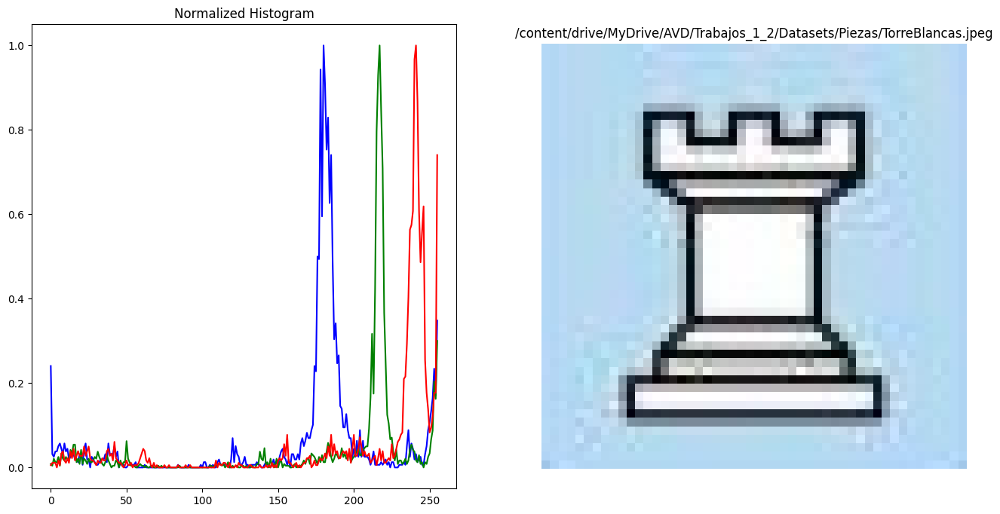

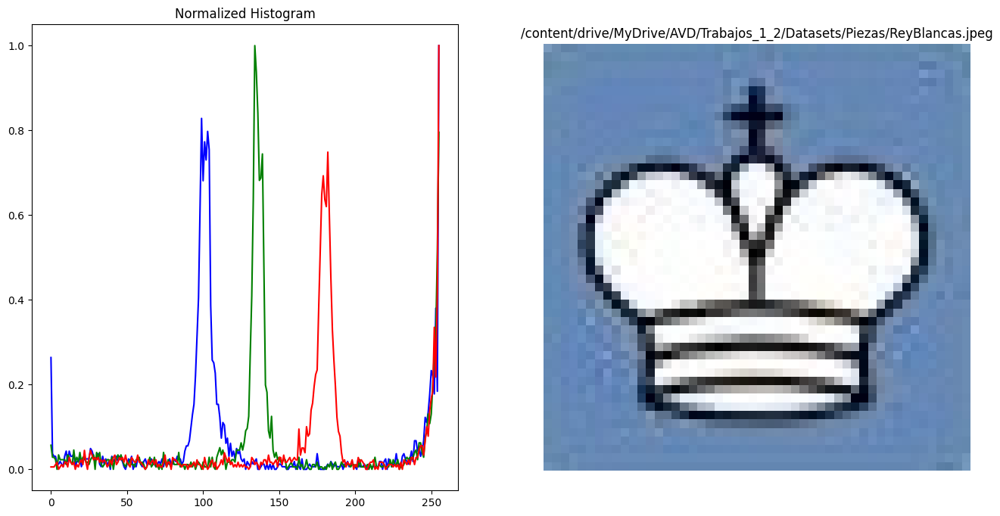

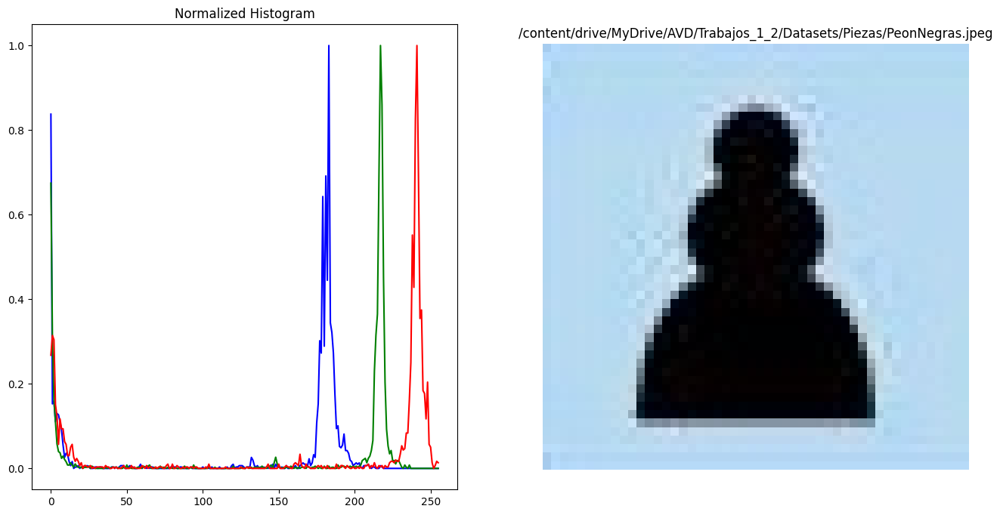

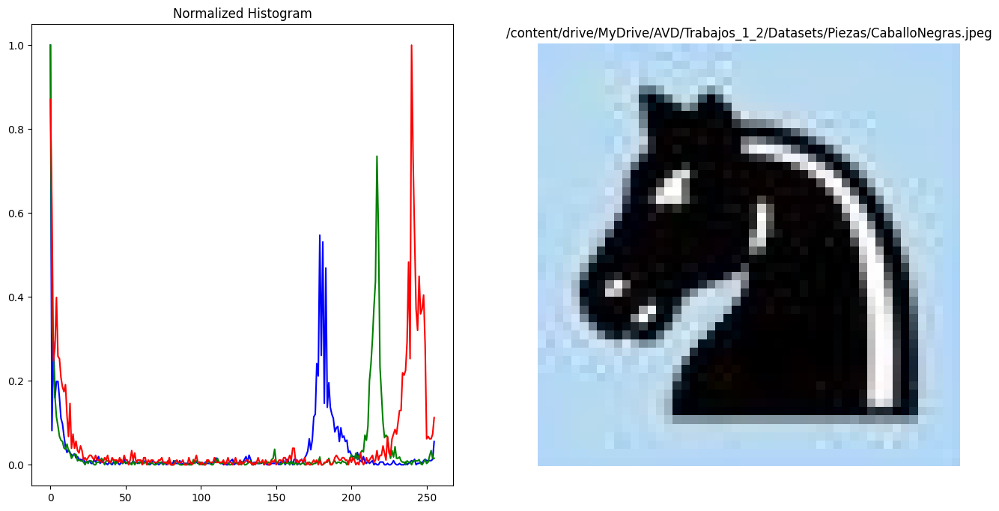

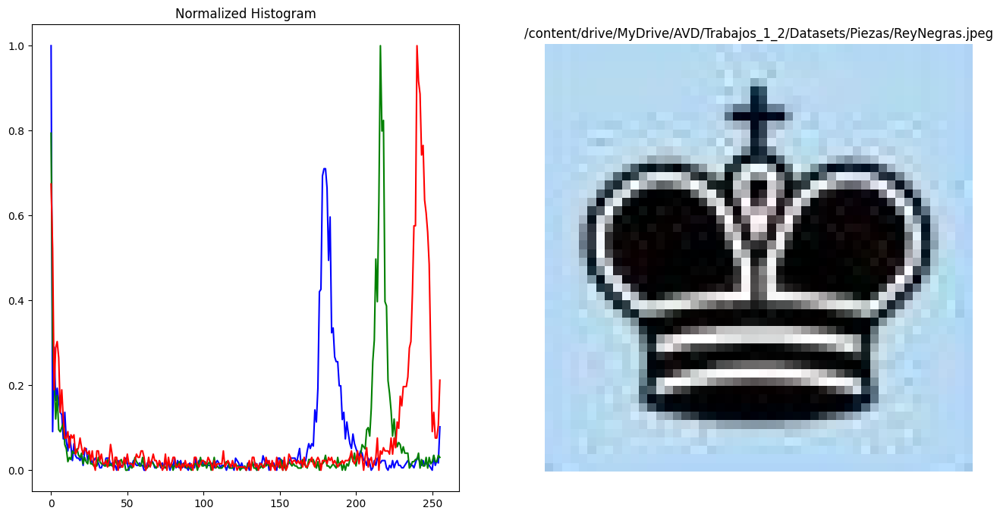

...

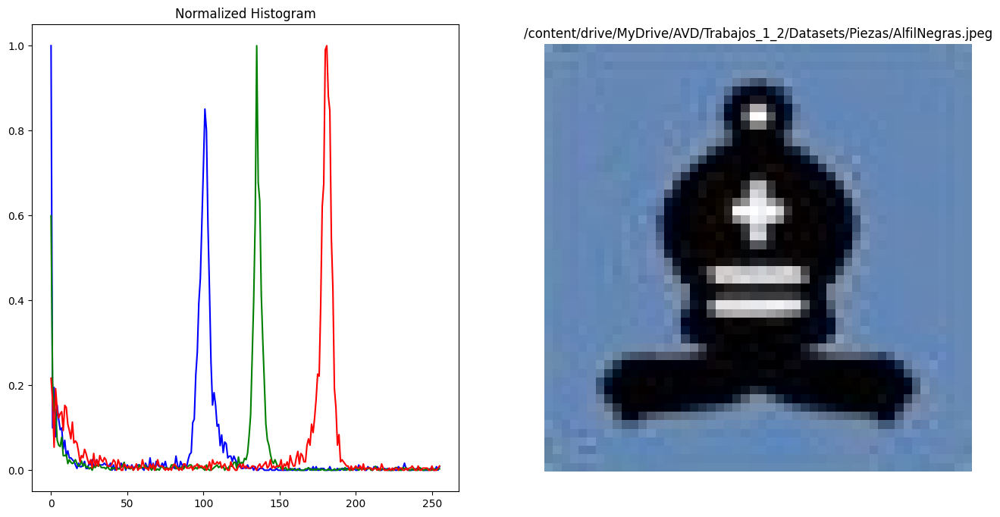

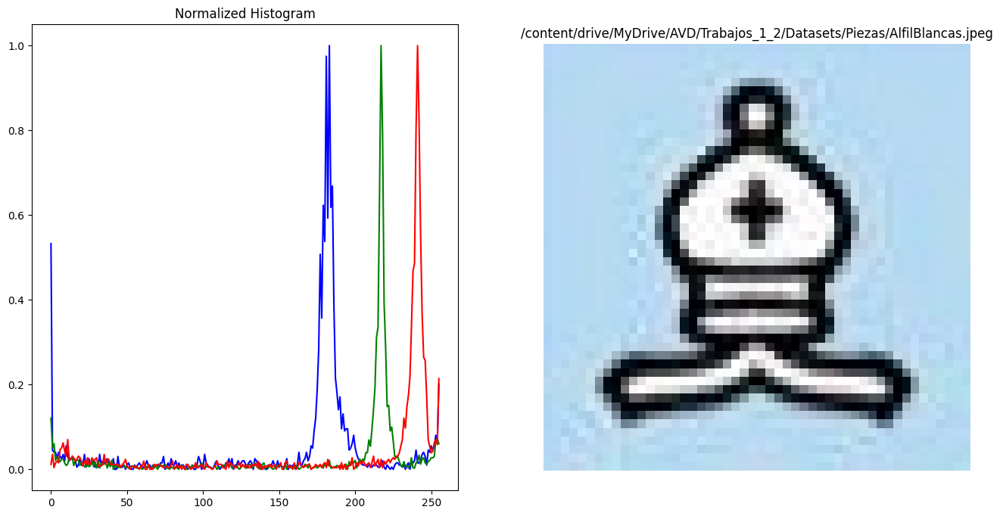

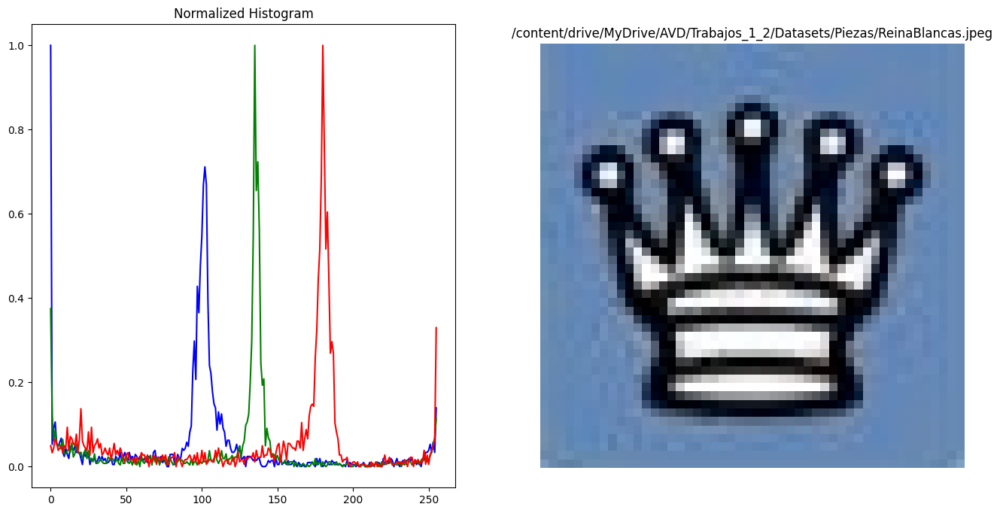

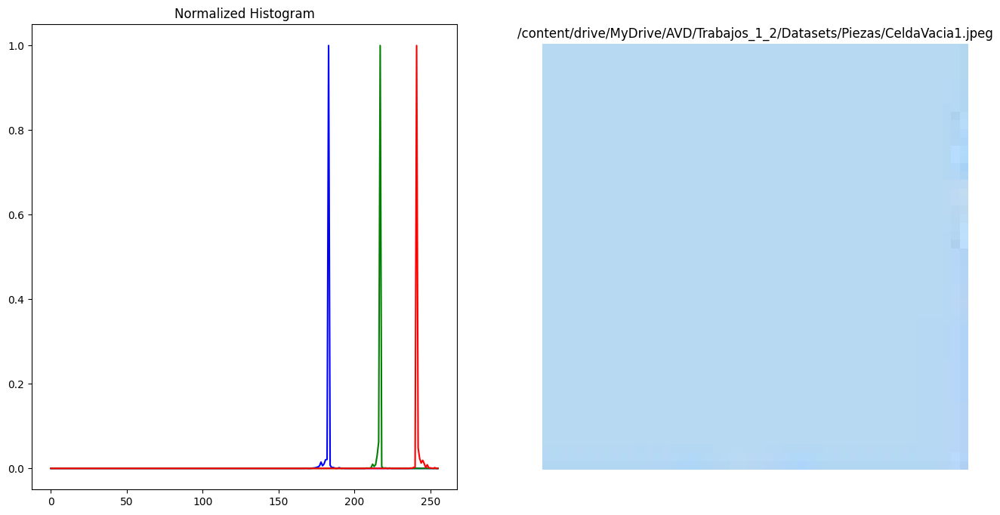

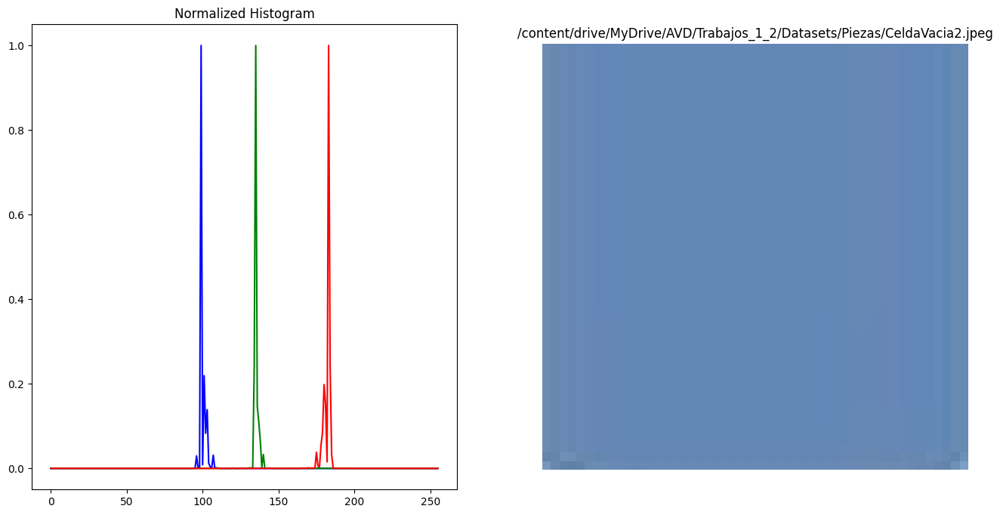

In [27]:
for i in piezas_images_paths:
    image = cv2.imread(i)
    color = ('b','g','r')
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

    for channel,col in enumerate(color):
      histr = cv2.calcHist([image],[channel],None,[256],[0,256])
      cv2.normalize(histr, histr, 0, 1, cv2.NORM_MINMAX)
      ax1.plot(histr,color = col)

    ax1.set_title('Normalized Histogram')

    ax2.imshow(image)
    ax2.set_title(i)


    plt.gca().set_axis_off()
    plt.show()

Podemos ver que las imágenes presentan picos en los mismos valores. Aquellas imagenes con fondo negro (casillas negras) lo presentan sobre la mitad del histograma y las que tienen fondo blanco (casillas blancas) sobre el final del histograma. Sin embargo, a nosotros no nos interesa conocer el color de la casilla, sino de la pieza en sí, por lo que probamos a estudiar los histogramas en escala de grises

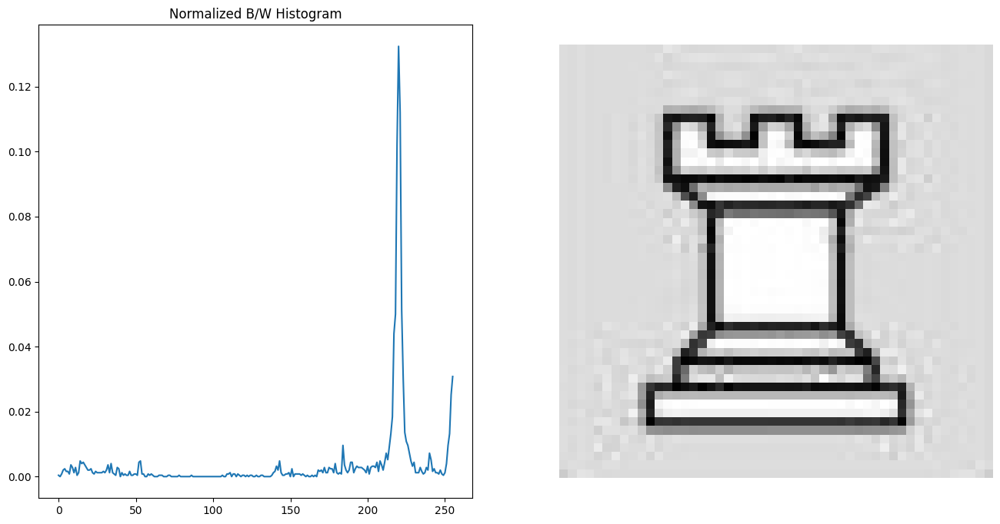

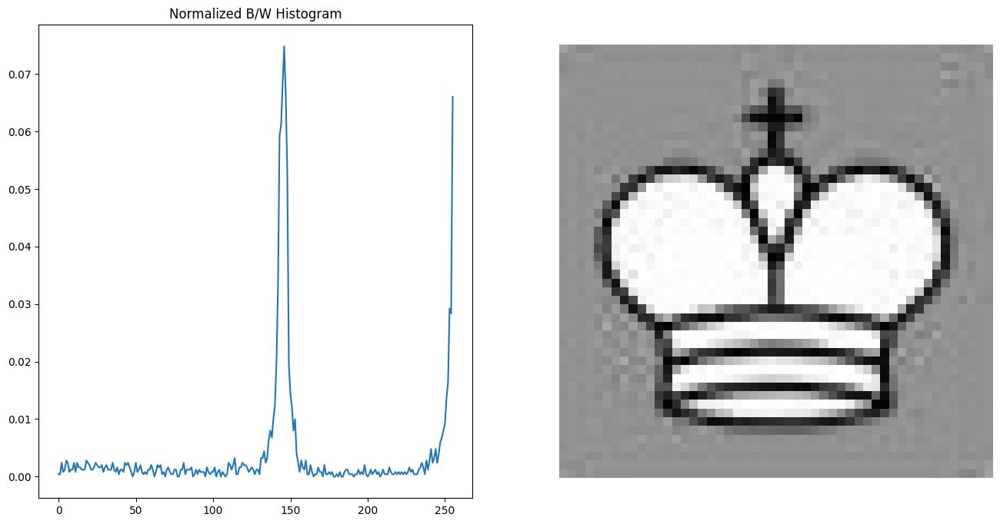

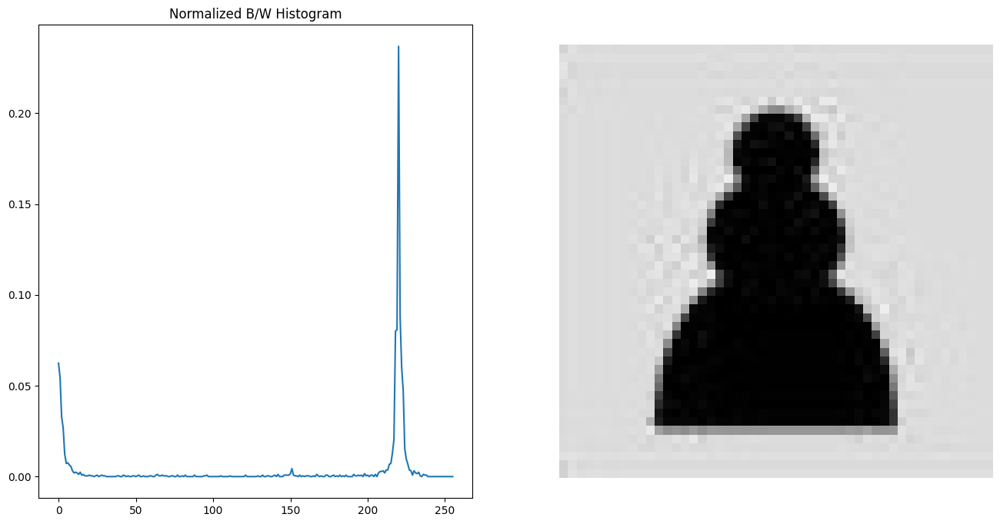

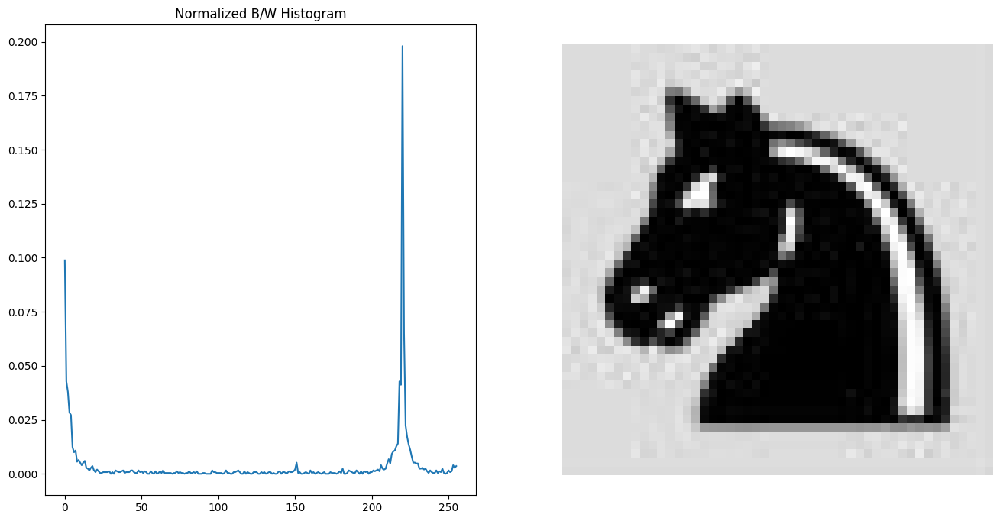

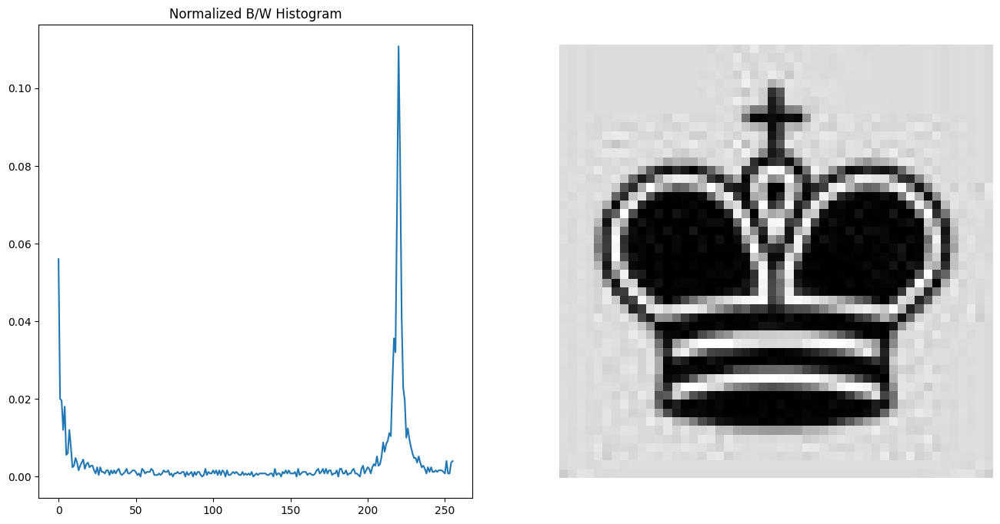

...

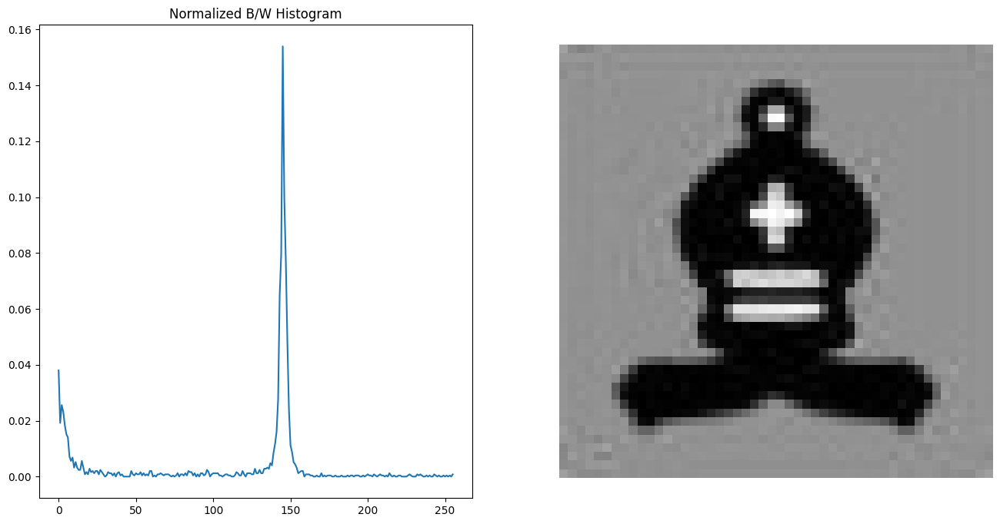

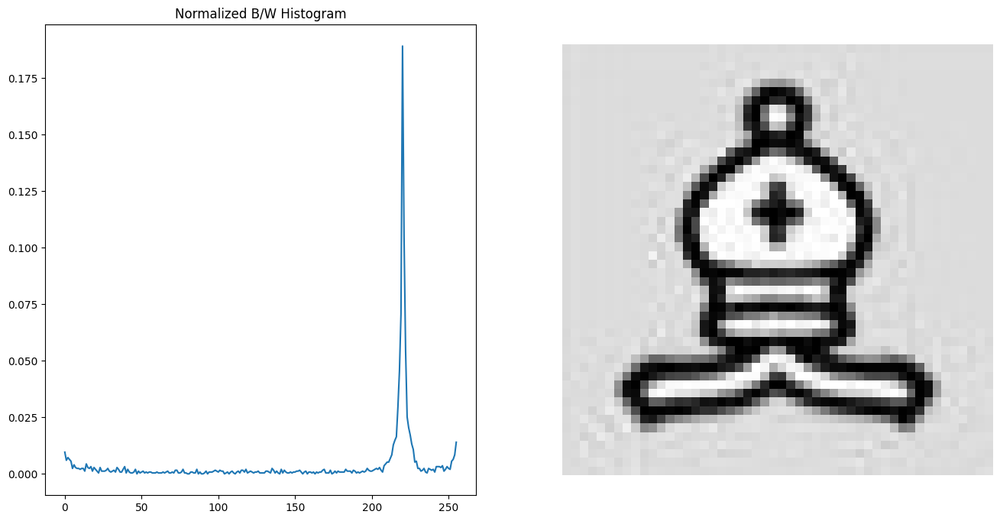

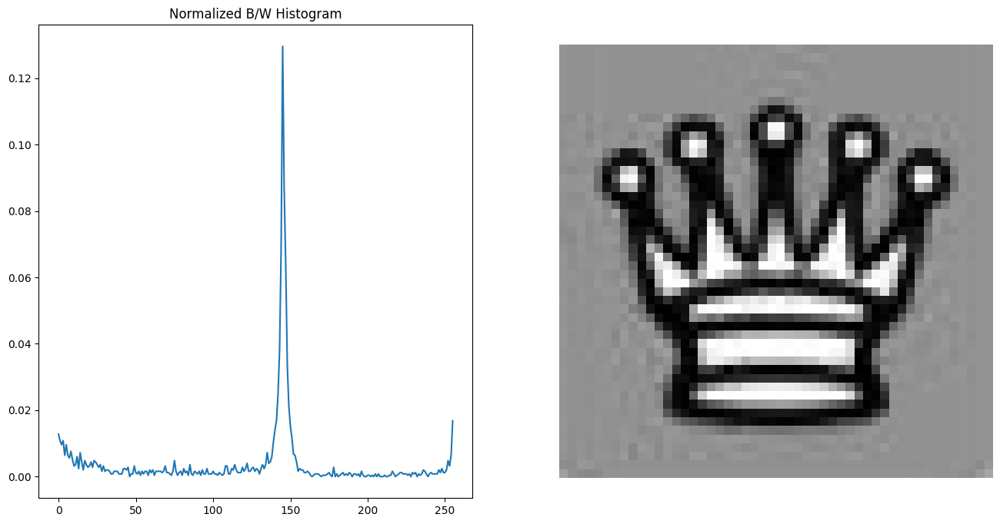

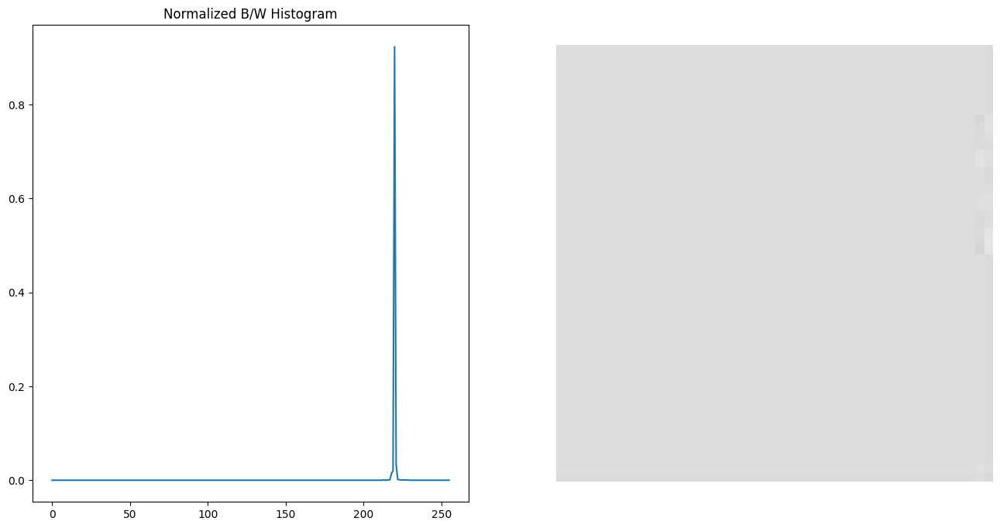

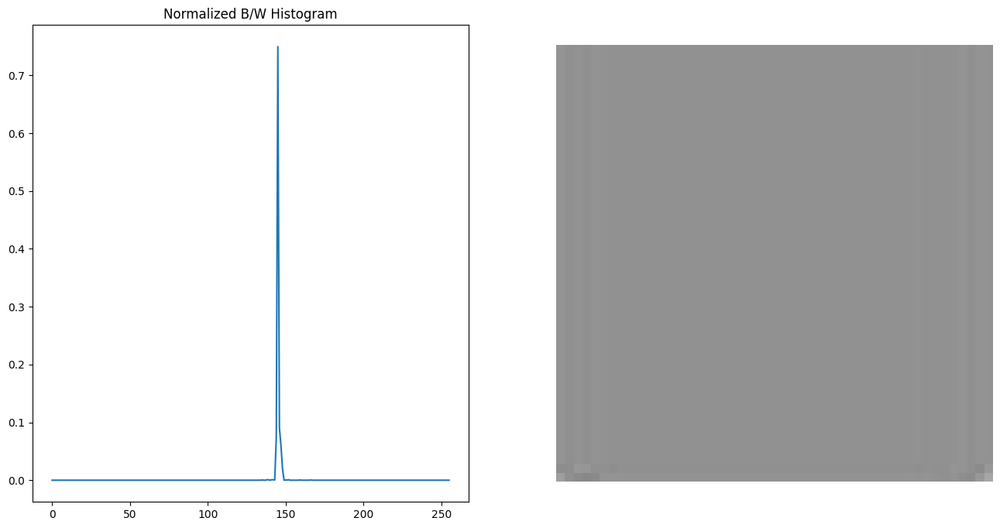

In [28]:
for image_path in piezas_images_paths:
  image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
  image_bw= np.dstack([image, image, image])
  fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))
  # construct a grayscale histogram
  hist = cv2.calcHist([image_bw], [0], None, [256], [0, 256])

  # normalize the histogram
  hist /= hist.sum()

  ax1.plot(hist)
  ax1.set_title('Normalized B/W Histogram')

  ax2.imshow(image_bw)


  plt.gca().set_axis_off()
  plt.show()

Aquí observamos que los histogramas tienen dos picos. Uno más pequeño en los extremos (En el 0 para las piezas negras y en 256 para las blancas) y uno en el "interior" que corresponde, de nuevo, al fondo de la pieza. De esta manera con el histograma en blanco y negro podremos identificar de que color es cada pieza, puesto que el valor en 0 será > al de 256 en las piezas negras y al contrario para las blancas. Asimismo nos permite diferenciar entre casillas sin fichas y con fichas (Valor en 0 = Valor en 256, para casillas sin fichas)

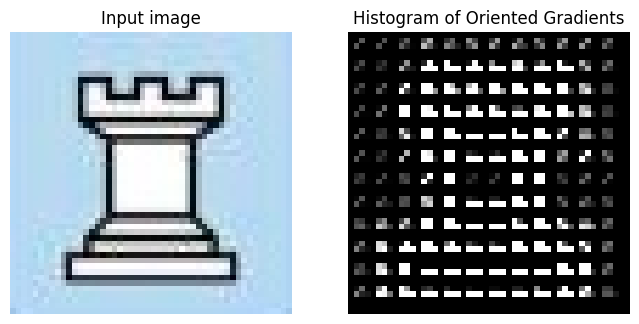

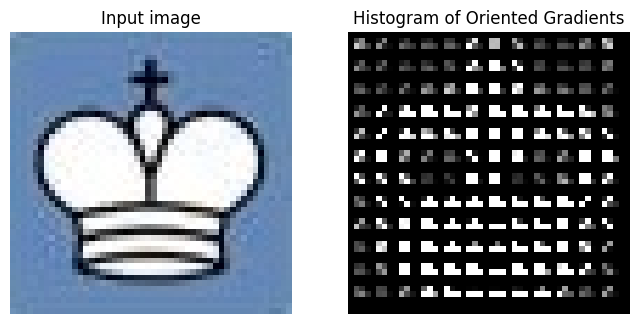

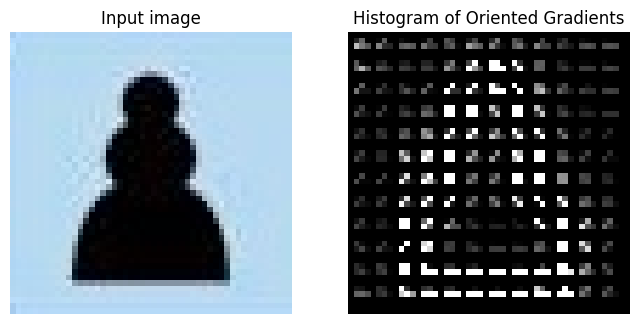

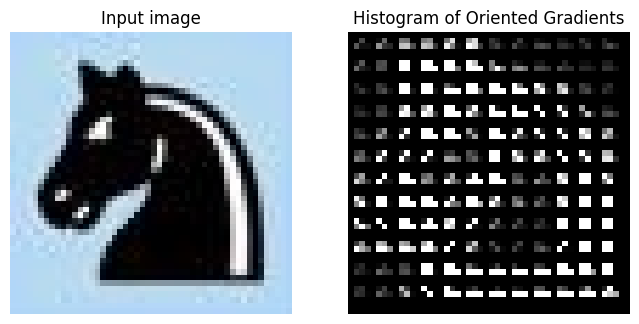

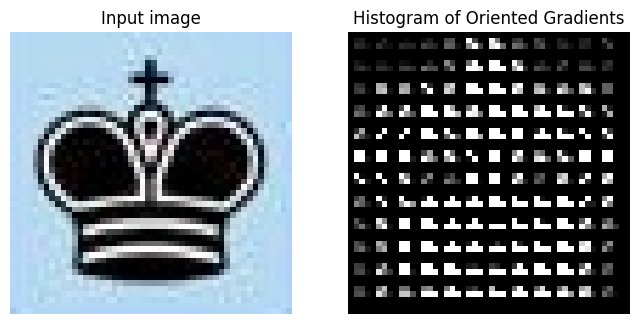

...

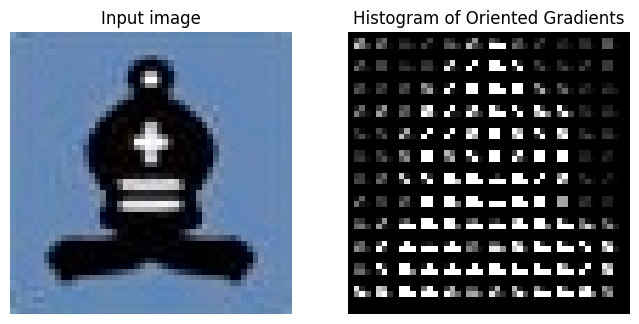

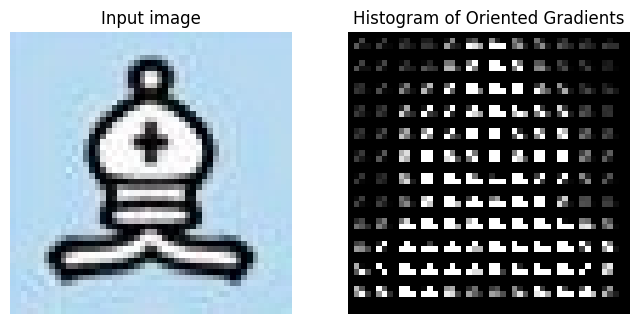

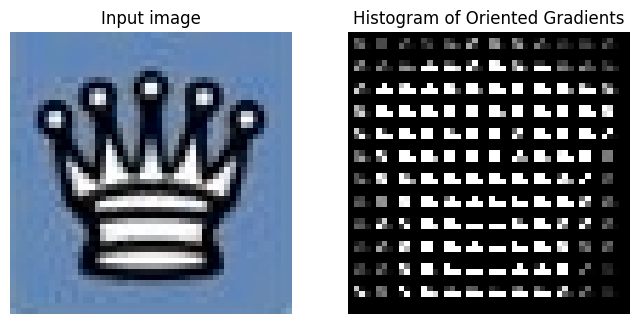

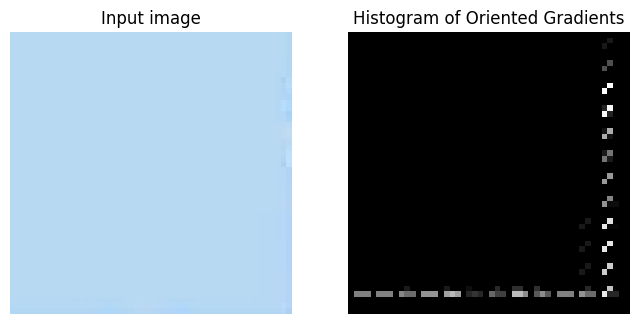

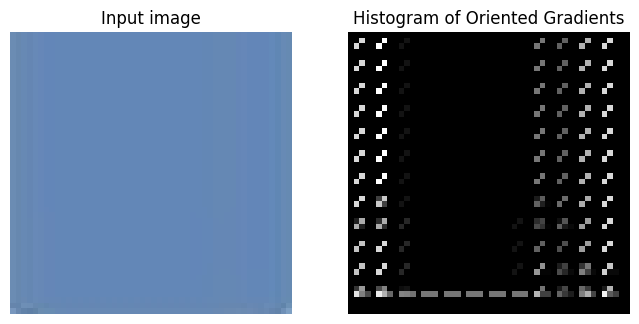

In [29]:
for i in range(len(piezas_images)):

  fd, hog_image = hog(piezas_images[i], orientations=9, pixels_per_cell=(4, 4),
                      cells_per_block=(2, 2), visualize=True, channel_axis=-1)

  fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(8, 4), sharex=True, sharey=True)
  ax1.axis('off')
  ax1.imshow(piezas_images[i], cmap=plt.cm.gray)
  ax1.set_title('Input image')

  # Rescale histogram for better display
  hog_image_rescaled = exposure.rescale_intensity(hog_image, in_range=(0, 10))
  ax2.axis('off')
  ax2.imshow(hog_image_rescaled, cmap=plt.cm.gray)
  ax2.set_title('Histogram of Oriented Gradients')
  plt.show()

Como hemos comentado, el color de la pieza lo diferenciaremos con el histograma de color, pero para distinguir dentro de un color cada una de las piezas, nos basaremos en el HOG, ya que capta muy bien las "siluetas" de las imágenes.

## Ventana deslizante, extracción de caracteríticas y clasificación de la pieza
Este es el apartado dónde se desarrollará el grueso del programa completo. Dado que estamos haciendo una detección de objetos, emplearemos, al igual que vimos en ejemplos del laboratorio, una ventana deslizante para recorrer la imagen y clasificar la parte extraída mediante la ventana. Nota: Tenga en cuenta que las imágenes son de 400x400 píxeles y que cada casilla del tablero ocupa por tanto 50x50 píxeles.

Una vez extraído el contenido de la ventana se aplicarán los mismos descriptores de características empleados en apartados anteriores para con ellos clasificar la pieza.

Finalmente, debe realizar una comparación con los vectores de características que almacenó previamente para clasificar el tipo de pieza y si es del jugador de las blancas o de las negras. Para esta comparativa puede usar una simple mñetrica de distancia como la distancia euclídea, distancia del coseno, entre otras.

In [67]:
path_tableros='/content/drive/MyDrive/AVD/Trabajos_1_2/Datasets/Tableros/'

#Función que divide el tablero en casillas
def division_casillas(img):
  (cX, cY) = (50,50)
  casillas = []
  for i in range(8):
    for j in range(8):
      casillas.append(img[i*cX:(i+1)*cX, j*cX:(j+1)*cY])
  return casillas

def color_pieza(imagen):
    casillas = division_casillas(imagen)
    resultados = []
    for casilla in casillas:
      image_byn = cv2.cvtColor(casilla, cv2.COLOR_BGR2GRAY)
      image_bw= np.dstack([image_byn, image_byn, image_byn])
      hist = cv2.calcHist([image_bw],[0],None,[256],[0,256])
      if hist[0] > hist[255]:
          resultados.append("Negro")
      elif hist[0] < hist[255]:
          resultados.append("Blanco")
      else:
          resultados.append("No hay pieza")

    return resultados

image_path = os.path.join(path_tableros, "1B4R1-2K4p-8-8-R3n1k1-8-8-n4r1N.jpeg")
image = cv2.imread(image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
casillas = division_casillas(image)
color_pieza(image)

['No hay pieza',
 'Blanco',
 'No hay pieza',
 'No hay pieza',
 'No hay pieza',
 'No hay pieza',
 'Blanco',
 'No hay pieza',
 'No hay pieza',
 'No hay pieza',
 'Blanco',
 'No hay pieza',
 'No hay pieza',
 'No hay pieza',
 'No hay pieza',
 'Negro',
 'No hay pieza',
 'No hay pieza',
 'No hay pieza',
 'No hay pieza',
 'No hay pieza',
 'No hay pieza',
 'No hay pieza',
 'No hay pieza',
 'No hay pieza',
 'No hay pieza',
 'No hay pieza',
 'No hay pieza',
 'No hay pieza',
 'No hay pieza',
 'No hay pieza',
 'No hay pieza',
 'Blanco',
 'No hay pieza',
 'No hay pieza',
 'No hay pieza',
 'Negro',
 'No hay pieza',
 'Negro',
 'No hay pieza',
 'No hay pieza',
 'No hay pieza',
 'No hay pieza',
 'No hay pieza',
 'No hay pieza',
 'No hay pieza',
 'No hay pieza',
 'No hay pieza',
 'No hay pieza',
 'No hay pieza',
 'No hay pieza',
 'No hay pieza',
 'No hay pieza',
 'No hay pieza',
 'No hay pieza',
 'No hay pieza',
 'Negro',
 'No hay pieza',
 'No hay pieza',
 'No hay pieza',
 'No hay pieza',
 'Negro',
 'No 

Tras realizar una prueba, vimos que clasificaba perfectamente por color. Ahora re-utilizaremos la función search usada en el anterior ejercicio, pero adaptada sólo para comparar los Histograms of Gradients y conseguir catalogar cada ficha.

In [66]:
def search(query, database, n_results=2):
    results = {}
    for key in database.keys():
        image_byn = cv2.cvtColor(query, cv2.IMREAD_GRAYSCALE)
        image_bw= np.dstack([image_byn, image_byn, image_byn])
        fd, hog_image = hog(image_bw, orientations=9, pixels_per_cell=(4, 4), cells_per_block=(2, 2), visualize=True, channel_axis=-1)
        d = np.linalg.norm(database[key]["HOG"] - fd)
        results[key] = d
    results = {k: v for k, v in sorted(results.items(), key=lambda item: item[1])}
    return list(results.keys())[:n_results]


for image_file in chess_features_vectors.keys():
    query = cv2.imread(image_file)
    results = search(query, chess_features_vectors, n_results=2)
    print(image_file, "  Las imagenes más parecidas son: ", results)

/content/drive/MyDrive/AVD/Trabajos_1_2/Datasets/Piezas/TorreBlancas.jpeg   Las imagenes más parecidas son:  ['/content/drive/MyDrive/AVD/Trabajos_1_2/Datasets/Piezas/TorreBlancas.jpeg', '/content/drive/MyDrive/AVD/Trabajos_1_2/Datasets/Piezas/TorreNegras.jpeg']
/content/drive/MyDrive/AVD/Trabajos_1_2/Datasets/Piezas/ReyBlancas.jpeg   Las imagenes más parecidas son:  ['/content/drive/MyDrive/AVD/Trabajos_1_2/Datasets/Piezas/ReyBlancas.jpeg', '/content/drive/MyDrive/AVD/Trabajos_1_2/Datasets/Piezas/ReyNegras.jpeg']
/content/drive/MyDrive/AVD/Trabajos_1_2/Datasets/Piezas/PeonNegras.jpeg   Las imagenes más parecidas son:  ['/content/drive/MyDrive/AVD/Trabajos_1_2/Datasets/Piezas/PeonNegras.jpeg', '/content/drive/MyDrive/AVD/Trabajos_1_2/Datasets/Piezas/PeonBlancas.jpeg']
/content/drive/MyDrive/AVD/Trabajos_1_2/Datasets/Piezas/CaballoNegras.jpeg   Las imagenes más parecidas son:  ['/content/drive/MyDrive/AVD/Trabajos_1_2/Datasets/Piezas/CaballoNegras.jpeg', '/content/drive/MyDrive/AVD/Trab

Ha clasificado a la perfección cada pieza.

## Extracción final del código FEN para la imagen de entrada
Mediante las detecciones realizadas, convierta ahora esa información en la codificación FEN descrita al inicio del ejercicio.

Definimos nuestra función FEN que transformará las imágenes de los tableros en la formulación adecuada.

In [126]:
def FEN(image):
  result = ""
  casillas = division_casillas(image)
  colores = color_pieza(image)
  contador, contador_2, contador_3 = 0, 0, -1
  for i in colores:
    contador_2 += 1
    contador_3 += 1
    if contador_2 < 8:
      if i == "Blanco":
        if contador != 0:
          result += str(contador)
          contador = 0
        resultado = search(casillas[contador_3], chess_features_vectors, n_results=1)[0]

        if "Alfil" in resultado:
          result += "B"
        elif "Caballo" in resultado:
          result += "N"
        elif "Torre" in resultado:
          result += "R"
        elif "Rey" in resultado:
          result += "K"
        elif "Reina" in resultado:
          result += "Q"
        elif "Peon" in resultado:
          result += "P"

      elif i == "Negro":
        if contador != 0:
          result += str(contador)
          contador = 0
        resultado = search(casillas[contador_3], chess_features_vectors, n_results=1)[0]

        if "Alfil" in resultado:
          result += "b"
        elif "Caballo" in resultado:
          result += "n"
        elif "Torre" in resultado:
          result += "r"
        elif "Rey" in resultado:
          result += "k"
        elif "Reina" in resultado:
          result += "q"
        elif "Peon" in resultado:
          result += "p"

      else:
        contador += 1

    elif contador_2 == 8:
      contador_2 = 0
      if i == "Blanco":
        if contador != 0:
          result += str(contador)
          contador = 0
        resultado = search(casillas[contador_3], chess_features_vectors, n_results=1)[0]
        if "Alfil" in resultado:
          result += "B"
        elif "Caballo" in resultado:
          result += "N"
        elif "Torre" in resultado:
          result += "R"
        elif "Rey" in resultado:
          result += "K"
        elif "Reina" in resultado:
          result += "Q"
        elif "Peon" in resultado:
          result += "P"

      elif i == "Negro":
        if contador != 0:
          result += str(contador)
          contador = 0
        resultado = search(casillas[contador_3], chess_features_vectors, n_results=1)[0]

        if "Alfil" in resultado:
          result += "b"
        elif "Caballo" in resultado:
          result += "n"
        elif "Torre" in resultado:
          result += "r"
        elif "Rey" in resultado:
          result += "k"
        elif "Reina" in resultado:
          result += "q"
        elif "Peon" in resultado:
          result += "p"
      else:
        if contador == 0:
          result += str(1)
        else:
          result += str(contador+1)
        contador = 0
      result += "/"

  return(result)

1B4R1/2K4p/8/8/R3n1k1/8/8/n4r1N/


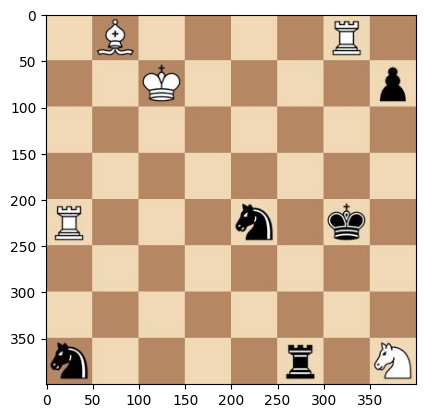

In [127]:
image_path = os.path.join(path_tableros, "1B4R1-2K4p-8-8-R3n1k1-8-8-n4r1N.jpeg")
image = cv2.imread(image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
plt.imshow(image)
print(FEN(image))

## Análisis de errores
Aplique su solución a las 5 imágenes que se proporcionan. Las piezas no son totalmente iguales en todas ellas pero si muy parecidas. Analice si ocurre algún error o errores, grafique todo lo que considere necesario y describa en detalle por qué puede estar sucediendo y que podría hacerse para solucionarlos.

In [129]:
for i in os.listdir(path_tableros):
  image_path = os.path.join(path_tableros, i)
  image = cv2.imread(image_path)
  image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
  print(FEN(image), "   ", i)

1B4R1/2K4p/8/8/R3n1k1/8/8/n4r1N/     1B4R1-2K4p-8-8-R3n1k1-8-8-n4r1N.jpeg
1b6/2K5/1P6/q7/8/P2k3R/1b6/7B/     1B6-2K5-1P6-q7-8-P2k3R-1b6-7B.jpeg
1K6/3B4/rR6/8/3k4/6B1/6q1/5b2/     1K6-3B4-rR6-8-3k4-6B1-6q1-5b2.jpeg
1K6/N1PN4/3n4/1qp3Np/b6p/8/3r4/1bk3N1/     1K6-N1PN4-3n4-1qp3Np-B6p-8-3r4-1bk3N1.jpeg
1q1n4/P7/2P5/1nk5/7q/1K6/1N2qp2/5RN1/     1Q1n4-P7-2P5-1nk5-7Q-1K6-1N2qp2-5RN1.jpeg
1b6/3P4/6B1/K7/7k/7b/2R5/2N1b3/     1b6-3P4-6B1-K7-7k-7b-2R5-2N1b3.jpeg


Comparamos el nombre del archivo con la formulación generada por nuestra función, destacando que  en general sólo hay un tipo de error.
En el cuarto tablero (y en algún caso específico de otros tableros) no detecta la mayoría de las piezas (casualmente las blancas). Veamos por qué.

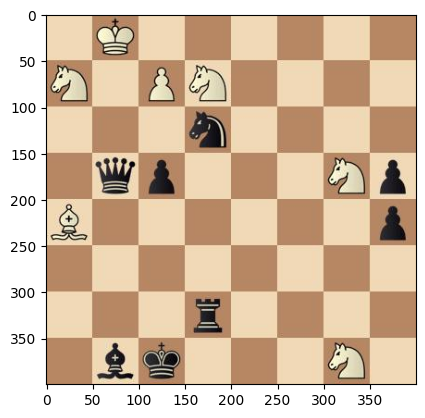

In [107]:
image_path = os.path.join(path_tableros, "1K6-N1PN4-3n4-1qp3Np-B6p-8-3r4-1bk3N1.jpeg")
image = cv2.imread(image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
plt.imshow(image)

A primera vista, el color de las piezas blancas no parece blanco como tal, veamos el histograma de una de sus piezas (El caballo de arriba a la izquierda).

[0.] [0.]


Text(0.5, 1.0, 'Normalized B/W Histogram')

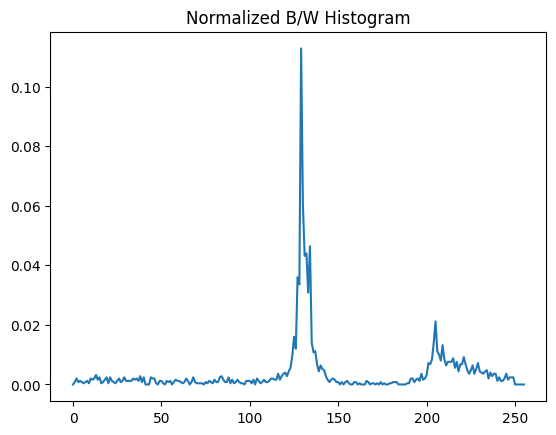

In [118]:
image_byn = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
image_bw= np.dstack([image_byn, image_byn, image_byn])
casillas = division_casillas(image_bw)
hist = cv2.calcHist([casillas[8]],[0],None,[256],[0,256])
hist /= hist.sum()
print(hist[0], hist[255])
plt.plot(hist)
plt.title('Normalized B/W Histogram')


E aquí el problema, los valores en los extremos (0 y 255) son los mismos, por lo que tal y como hemos definido nuestra función de decisión, se estima que no hay ficha en la casilla.

La solución a este problema sería tomar intervalos en los extremos y aplicar la media o el máximo, para que al comparar un extremo con otro, no haya problema, ni confusión (Hemos probado con distintos valores, pero ninguno parecía solucionar la cuestión, puesto que cuando parecía que lo habías conseguido, alguna ficha se "cambiaba de equipo").


# 3 Extracción de características con Deep Learning y búsqueda de imágenes
Se va a comprobar ahora el poder de la inteligenciar artificial para la extracción de características en imagen. Para ello se pretende desarrollar a continuación el mismo motor de búsqueda que se creó en el primer apartado (para el dataset de las flores) pero ahora en lugar de emplear algoritmos destinados a la extracción de características en imagen, se van a extraer estos vectores mediante redes neuronales. Se va a realizar la comprobación mediante tres técnicas.

1. Empleo de una rede neuronal pre-entrenada en un dataset con gran cantidad de clases.
2. Finetuning de la red neuronal modificando parte de la red de cara a entrenar sólo unas capas de la red.
3. Entrenamiento completo de la red neuronal.

Con estos tres experimentos se van a comprobar varias cosas. El primero de ellos nos ayudará a comprender si una red pre-entrenada seleccionada, sin ser entrenada de nuevo en el dataset bajo estudio, es capaz de extraer características relevantes de las imágenes. Con el segundo, mantendremos una parte de la red sin reentrenar, y sólo se entrenará la parte final para realizar una clasificación. Esto nos servirá para comprobar si el reentranimento de unas pocas capas es suficiente para mejorar los resultados dado lo costodo d eentrenar la red completa. Finalmente entrenaremos la red completa de principio a fin para comprobar si los resultados mejoran notablemente en comparación con los anteriores. Realizados todos los experimentos se abre una sección final en la que se realizará una comparativa en detalle de los resultados obtenidos en el apartado 1 y los obtenidos con estos nuevos experimentos extrayendo las conclusiones más relevantes.

Para todo el desarrollo se va a emplear la red ResNet18 pre-entrenada en un dataset similar al empleado pero mucho más grande. Este dataset tiene el nombre de Oxford 102 Flowers Dataset y se puede encontrar toda la información relativa al mismo en el siguiente enlace:

- https://www.robots.ox.ac.uk/~vgg/data/flowers/102/

Como resumen general el dataset se compone de 102 clases distintas de flores (muchas más que en nuestro problema original con 17 clases). Este dataset se ha empleado previamente para gran cantidad de experimentos generales y pruebas por lo que ya existen modelos de inteligencia artificial mediante redes convolucionales para clasificación previamente entrenados en el. Específicamente, vamos a empelar para este desarrollo el modelo ResNet18 el cual podemos encontrar entrenado en diferentes fuentes con una precisión que alcanza el 93% en el conjunto de evaluación de este dataset.

Esta red se puede encontrar definida por defecto dentro de la librería pytorch concretamente en el paquete adicional torchvision el cual proporciona gran cantidad de las redes por defecto más empleadas en la literatura a modo de extractores de características.

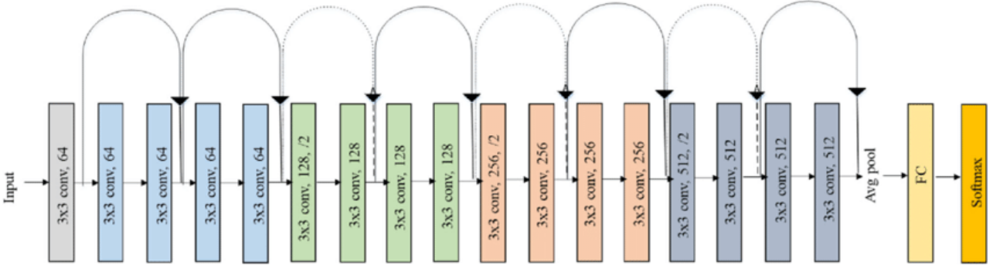

Como se observa en la figura anterior la red se compone de diversas capas convolucionales con la idea propuesta por ResNet de la residualidad. Finalmente se añade un average pooling y un clasificador mediante capas totalmente conectadas de neuronas. En el siguiente código se proporcionará directamente el código para utilizar esta red ya preentrenada y extraer los vectores de características que serán los que vamos a emplear para realizar la búsqueda.

In [30]:
# Imports here
import torch
import numpy as np
import pandas as pd
from torchvision import datasets
from torch.utils.data import DataLoader, random_split
import torchvision.transforms as transforms
from torch.utils.data.sampler import SubsetRandomSampler
import torchvision.models as models
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.optim import lr_scheduler
from torch.autograd import Variable
from PIL import Image
import os
import json
import matplotlib.pyplot as plt
from glob import glob
from tqdm import tqdm
import time
import copy

En este apartado se va a cargar el modelo ResNet18 de la librería torchvision y se va a reemplazar la parte del clasificador (capas de neuronas totalmente conectadas) que proporciona por defecto para que sea el mismo que la red que se proporciona entrenada.

In [31]:
# Function that loads a checkpoint and rebuilds the model
# Loading ResNet18 torchvision default implementation and modifying fully connected layers with the ones in the pretrained model
model = models.resnet18()
num_features = model.fc.in_features
model.fc = nn.Sequential(
                        nn.Linear(num_features, 512),
                          nn.ReLU(),
                          nn.BatchNorm1d(512),
                          nn.Dropout(0.4),
                          nn.Linear(512, 102), # Last layer has 102 neurons (102 classes in the dataset)
                          nn.LogSoftmax(dim=1))

# Loading pretrained model from provided file
model.load_state_dict(torch.load(main_datasets_path+"model_resnet18_102flowers.pt", map_location=torch.device('cpu'))["state_dict"])

# Model in evaluation mode
model.eval()

# Model in CPU or GPU if available
if torch.cuda.is_available():
    model = model.cuda()

In [32]:
# Function to preprocess the image to have the correct input format, input: path to the image
def process_image(image):
    ''' Scales, crops, and normalizes a PIL image for a PyTorch model,
        returns an Numpy array
    '''
    # images have to be normalized
    normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                 std=[0.229, 0.224, 0.225])
    # preprocess step
    preprocess = transforms.Compose([
            transforms.Resize(256),
            transforms.CenterCrop(224),
            transforms.ToTensor(),
            normalize
        ])
    loaded_image = Image.open(image)
    img_tensor = preprocess(loaded_image).float()
    img_tensor = img_tensor.unsqueeze(0)
    np_image = np.array(img_tensor)
    return np_image

In [33]:
# Function to predict the topK labels with the trained model
def predict(image_path, model, topk=5):
    ''' Predict the class (or classes) of an image using a trained deep learning model.
    '''
    # preprocess image and added to GPU if available
    img_tensor = process_image(image_path)
    img_tensor = torch.from_numpy(img_tensor)
    if torch.cuda.is_available():
        img_tensor = img_tensor.cuda()
    # Pass the image to the network
    output = model(img_tensor)
    # softmax layer to convert the output to probabilities
    m = nn.Softmax()
    output = m(output)
    # Get probabilities from the output and convert to labels
    probabilities = torch.topk(output,5)[0]
    labels = torch.topk(output,5)[1]
    if torch.cuda.is_available():
        probabilities = probabilities.cpu()
        labels = labels.cpu()

    return probabilities.detach().numpy(), labels.detach().numpy()

Aquí se realiza la predicción para una imagen. La salida de la red neuronal nos proporciona las probabilidades y predicciones de las topK clases. Para conocer el nombre de la clase empleamos el fichero de conversión proporcionado en el dataset.

In [34]:
test_img_path = "Dataset_Flores/Bluebell/image_0241.jpg"
topk = 5
probs, preds = predict(test_img_path, model, topk)
print("Clases predichas y probabilidades:")
print(preds, probs)

path_labels_coding = main_datasets_path+"cat_to_name.json"
# Open the JSON file for reading
with open(path_labels_coding, "r") as json_file:
    # Parse the JSON data
    cat_to_name = json.load(json_file)

idx_to_name = {category: cat_to_name[str(category+1)] for category in preds[0]}
classes = list(idx_to_name.values())
print('This flower is most likely a {} with a {:.6f} probability!'.format(classes[0], probs[0][0]))
print('This flower could also possibly be:')
for i in range(len(probs[0])):
    if i != 0:
        print('{} with a {:.6f} probability'.format(classes[i], probs[0][i]))

/usr/local/lib/python3.10/dist-packages/torch/nn/modules/module.py:1511: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  return self._call_impl(*args, **kwargs)


Clases predichas y probabilidades:
[[23 20 77 85 79]] [[0.60425067 0.28624752 0.04374845 0.02259965 0.01387857]]
This flower is most likely a red ginger with a 0.604251 probability!
This flower could also possibly be:
fire lily with a 0.286248 probability
lotus lotus with a 0.043748 probability
tree mallow with a 0.022600 probability
anthurium with a 0.013879 probability


Necesitamos también que la red nos devuelva el vector de características que emplearemos para realizar la búsqueda. Para ello debemos acceder a la información que se predice en la red antes del clasificador.

In [35]:
# Function to predict the feature vector before the classifier in the network
def predict_feature_vector(image_path, model):
    ''' Predict the class (or classes) of an image using a trained deep learning model.
    '''
    # preprocess image and added to GPU if available. Delete fc layer
    model.fc = torch.nn.Identity()
    img_tensor = process_image(image_path)
    img_tensor = torch.from_numpy(img_tensor)
    if torch.cuda.is_available():
        img_tensor = img_tensor.cuda()
    # Pass the image to the network
    output = model(img_tensor)
    if torch.cuda.is_available():
        output = output.cpu()

    return output.detach().numpy()

In [36]:
test_img_path = "Dataset_Flores/Bluebell/image_0241.jpg"
feature_vector = predict_feature_vector(test_img_path, model)
print(feature_vector.shape)

(1, 512)


## Creación de la base de datos de vectores de características extraídos con la red neuronal
Para realizar la búsqueda se va a crear una base de datos que almacene todos los vectores de características de todas las imágenes. Lo que interesa ahora es extraer de cada imagen el vector de características de cada una de las imágenes en el deataset tras pasar por la red neuronal. Para ello, uitlice las funciones que previamente se presentan dónde debe introducir la ruta a la imagen y el código proporciona el vector de cactarísticas de tamaño (1, 512).

De manera muy similar a nuestro primer intento de motor de busqueda generamos los vectores de características, pero esta vez haciendo uso de uan nueva función y teniendo en cuenta todo lo explicado en este tercer apartado del cuadernillo

In [37]:
predicted_features_vectors = {}
species_path = '/content/drive/MyDrive/AVD/Trabajos_1_2/Datasets/Dataset_Flores/'
species = os.listdir(species_path)

for specie in species:
    image_files = os.listdir(species_path + specie)
    for image in image_files:
      vector = {}
      # Load the image
      image_path = species_path + specie + "/" + image
      predicted_features_vectors[image]= predict_feature_vector(image_path, model)

In [38]:
len(predicted_features_vectors)

1344

## Análisis en reducción de dimensionalidad (PCA, T-SNE, Otros métodos)
De cara a explorar más en detalle los vectores extraídos, puede emplear técnicas de reducción de dimensionalidad, clustering, entre otras para visualizar los resultados en gráficos y ver si existen diferencias notables en los vectores de características.

In [39]:
from sklearn.cluster import KMeans
n_clusters = 17
kmeans = KMeans(n_clusters=n_clusters)

## Desarrollo de la solución de búsqueda
Ahora debe desarrollar la solución que permita la búsqueda en la base de datos mediante una imágen "query" que se comparará con todas las de la base de datos. Para ello debe realizar la comparación del vector de características que desee emplear de la imagen query con el vector de características del mismo tipo de todas las imágenes de la base de datos. Para esta parte puede reutilizar el código que ya haya desarrollado previamente en tareas anteriores y emplear la métrica de distancia que considere oportuna.

De nuevo definimos una función de busqueda, pero adaptandonos a las nuevas circunstancias.

In [40]:
def new_search(image, database, n_results=10):
    results = {}
    for key in database.keys():
        features = predict_feature_vector(image, model)
        d = np.linalg.norm(database[key][0] - features)
        results[key] = d
    results = {k: v for k, v in sorted(results.items(), key=lambda item: item[1])}
    return list(results.keys())[:n_results]

## Análisis de resultados de búsqueda
Realice varias búsquedas para probar su solución con las imágenes "query" que se proprocionan en la carpeta adicional. Comente los resultados obtenidos en detalle, si cumplen las espectativas y que sucede con cada vector de características.

In [41]:
def show_results(query, results, species, species_path):
    #imprime la imagen de query y las 10 imagenes del resulado

    plt.figure(figsize=(20, 10))
    plt.subplot(1, 11, 1)
    plt.axis('off')
    query = cv2.imread(query)
    plt.imshow(cv2.cvtColor(query, cv2.COLOR_BGR2RGB))
    plt.title('Query')
    #para buscar las imagenes de los resultados se tienen que recorrer todas las especies y ver si el nombre del resultado coincide con alguno de los nombres de las imagenes de esa especie
    for i, result in enumerate(results):
      for specie in species:
        ruta=species_path+specie
        image_files = [file for file in os.listdir(ruta)]
        if result in image_files:
            image_path = os.path.join(ruta, result)
            image = cv2.imread(image_path)
            plt.subplot(1, 11, i+2)
            plt.axis('off')
            plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
            plt.title(specie)
            break


Comenzamos con las querys.

['image_0272.jpg', 'image_0082.jpg', 'image_0300.jpg', 'image_0583.jpg', 'image_1353.jpg', 'image_0107.jpg', 'image_0113.jpg', 'image_0266.jpg', 'image_1119.jpg', 'image_0269.jpg']


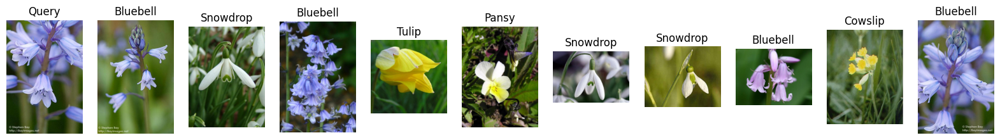

In [44]:
query_path = main_datasets_path + 'Flores_Query/'
image_files = query_path + 'Bluebell/'
fotos = os.listdir(image_files)
query = image_files + fotos[0]

results = new_search(query, predicted_features_vectors)
print(results)
array = os.listdir(main_datasets_path + path_to_flowers_dataset + "/")
show_results(query, results, array, main_datasets_path + path_to_flowers_dataset + "/" )

De nuevo, la primera busqueda no da los resultados esperados, no obstante, ha mejorado notablemente, debido a que ahora muestra varios ejemplos de "Bluebell" y flores bastante similares como "Snowdrop". Seguimos probando con más especies.

['image_0827.jpg', 'image_0834.jpg', 'image_0817.jpg', 'image_0815.jpg', 'image_0861.jpg', 'image_0812.jpg', 'image_0829.jpg', 'image_0826.jpg', 'image_0848.jpg', 'image_0828.jpg']


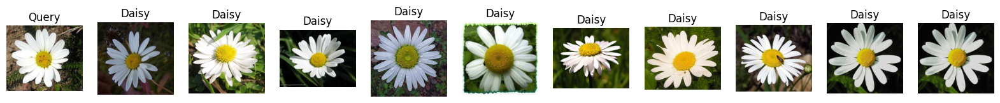

In [45]:
query_path = main_datasets_path + 'Flores_Query/'
image_files = query_path + 'Daisy/'
fotos = os.listdir(image_files)
query = image_files + fotos[0]

results = new_search(query, predicted_features_vectors)
print(results)
array = os.listdir(main_datasets_path + path_to_flowers_dataset + "/")
show_results(query, results, array, main_datasets_path + path_to_flowers_dataset + "/" )

Con las margaritas, ecncontramos nuestro primer resultado perfecto. Probablemente, es debido a que es una flor con una forma y una distribución de colores muy característica y homogénea. Aun así es una buena señal.

['image_1134.jpg', 'image_1144.jpg', 'image_1173.jpg', 'image_1154.jpg', 'image_1126.jpg', 'image_1124.jpg', 'image_1166.jpg', 'image_1138.jpg', 'image_1143.jpg', 'image_1174.jpg']


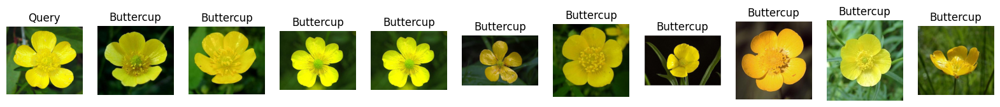

In [46]:
query_path = main_datasets_path + 'Flores_Query/'
image_files = query_path + 'Buttercup/'
fotos = os.listdir(image_files)
query = image_files + fotos[0]

results = new_search(query, predicted_features_vectors)
print(results)
array = os.listdir(main_datasets_path + path_to_flowers_dataset + "/")
show_results(query, results, array, main_datasets_path + path_to_flowers_dataset + "/" )

De nuevo, otro resultado perfecto. Esta vez es incluso más sorprendente puesto que el "Botón de Oro" es una flor con forma bastante estándar y amarilla (el amarillo se repite mucho en los ejemplos que hemos visualizado).

['image_0795.jpg', 'image_0736.jpg', 'image_0734.jpg', 'image_0729.jpg', 'image_0798.jpg', 'image_0723.jpg', 'image_0721.jpg', 'image_0787.jpg', 'image_0735.jpg', 'image_0751.jpg']


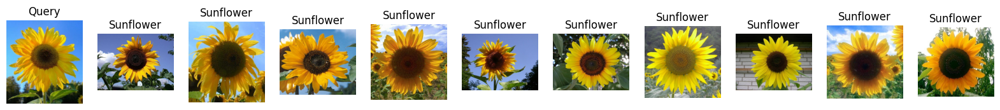

In [47]:
query_path = main_datasets_path + 'Flores_Query/'
image_files = query_path + 'Sunflower/'
fotos = os.listdir(image_files)
query = image_files + fotos[0]

results = new_search(query, predicted_features_vectors)
print(results)
array = os.listdir(main_datasets_path + path_to_flowers_dataset + "/")
show_results(query, results, array, main_datasets_path + path_to_flowers_dataset + "/" )

El girasol, también genial.

['image_0569.jpg', 'image_0024.jpg', 'image_0595.jpg', 'image_0072.jpg', 'image_1224.jpg', 'image_0567.jpg', 'image_0016.jpg', 'image_0571.jpg', 'image_0058.jpg', 'image_0562.jpg']


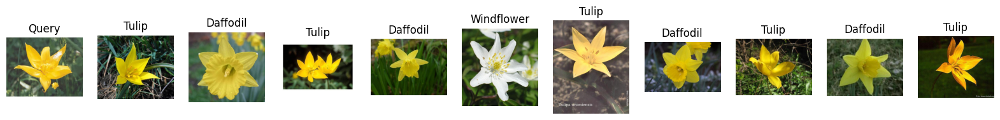

In [48]:
query_path = main_datasets_path + 'Flores_Query/'
image_files = query_path + 'Tulip/'
fotos = os.listdir(image_files)
query = image_files + fotos[0]

results = new_search(query, predicted_features_vectors)
print(results)
array = os.listdir(main_datasets_path + path_to_flowers_dataset + "/")
show_results(query, results, array, main_datasets_path + path_to_flowers_dataset + "/" )

Sin embargo, en la última busqueda vemos que el modelo no es infalible y que puede fallar si se dan las circunstancias (forma de la flor muy parecida a varias especies, color amarillo y verde...).

## Finetuning y reentrenamiento del modelo completo
Dado que la red neuronal preentrenada no es específica del dataset empleado en esta tarea, aunque es posible que contenga a alguna o varias de las clases puesto que está compuesto por 102 en total, podrían mejorarse los resultados reentrenando la red neuronal con el dataset bajo estudio. Dado que esto es una tarea costosa se propone dos alternativas para esta parte. Por un lado se proporciona el código para realizar el entrenamiento y evaluación de la red neuronal. Se proponen dos modalidades:

- Entrenamiento de parte de las capas (última convolución + clasificador), finetuning.
- Entrenamiento completo de la red.

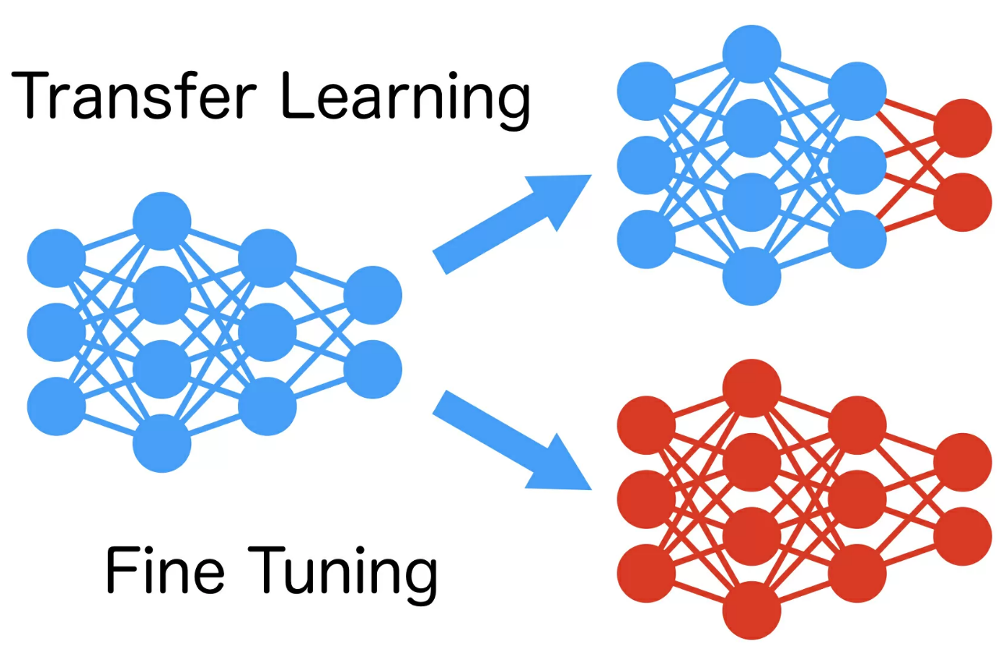

Para este apartado, seleccione una de las dos soluciones, entrene la red neuronal y utilice la red entrenada para crear de nuevo la base de datos de vectores de búsqueda. A continuación se proporciona el código para ambas soluciones de cara a seleccionar parte de las capas para que no se entrenen o para entrenar el modelo completo. Así mismo se proveé el código para entrenar y evaluar los resultados.

## Pytorch dataloder para el dataset de las flores proporcionado

In [49]:
# Pytorch dataloader for Flower dataset
# Define transforms for the training and validation sets
normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
data_transforms = transforms.Compose([
        transforms.RandomResizedCrop(size=256, scale=(0.8, 1.0)),
        transforms.RandomRotation(degrees=15),
        transforms.ColorJitter(),
        transforms.RandomHorizontalFlip(),
        transforms.CenterCrop(size=224),
        transforms.ToTensor(),
        normalize,
    ])

# Crear un dataset utilizando ImageFolder
dataset_dir = "Dataset_Flores"
dataset = datasets.ImageFolder(dataset_dir, transform=data_transforms)

# Tamaños para los conjuntos de train y validation
porcentaje_validation = 0.2
tamaño_validation = int(len(dataset) * porcentaje_validation)
tamaño_train = len(dataset) - tamaño_validation

# Dividir el dataset en train y validation
train_dataset, validation_dataset = random_split(dataset, [tamaño_train, tamaño_validation])

In [50]:
# Define batch size
batch_size = 32
# Using the image datasets and the trainforms, define the dataloaders
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
validate_loader = torch.utils.data.DataLoader(validation_dataset, batch_size=batch_size, shuffle=False)

data_loader = {}
data_loader['train'] = train_loader
data_loader['valid'] = validate_loader

In [51]:
# Testing dataloader sizes
for images, labels in data_loader["train"]:
    print("Batch images size: ", images.size())
    print("Labels batch size: ", labels.size())
    break

Batch images size:  torch.Size([32, 3, 224, 224])
Labels batch size:  torch.Size([32])


## Bucle de entrenamiento y validación

In [52]:
def train_model(model, criterion, optimizer, scheduler, gpu_mode, data_loader, n_epochs=10):
    # keeping track of best weights
    best_model_wts = copy.deepcopy(model.state_dict())
    valid_loss_min = np.Inf # track change in validation loss

    for epoch in range(1, n_epochs+1):
        # keep track of duration of each epoch
        since = time.time()
        running_losses  = {}
        running_accuracies  = {}
        for phase in ['train', 'valid']:
            # keep track of training and validation loss and accuracy
            running_loss = 0.0
            running_acc = 0.0
            if phase == 'train':
                model.train()  # Set model to training mode
            else:
                model.eval()   # Set model to evaluate mode

            for data, target in data_loader[phase]:
                # move tensors to GPU if CUDA is available
                if gpu_mode:
                    data, target = data.cuda(), target.cuda()

                # clear the gradients of all optimized variables
                optimizer.zero_grad()

                # forward pass: compute predicted outputs by passing inputs to the model
                output = model(data)
                # calculate the batch loss
                loss = criterion(output, target)

                # backward + optimize only if in training phase
                if phase == 'train':
                    # backward pass: compute gradient of the loss with respect to model parameters
                    loss.backward()
                    # perform a single optimization step (parameter update)
                    optimizer.step()

                # get prediction and accuracy in train and validation phase, convert output probabilities to predicted class
                _, preds = torch.max(output, 1)
                running_acc += torch.sum(preds == target.data)
                # update average running loss
                running_loss += loss.item()*data.size(0)

            # calculate average losses
            running_losses[phase] = running_loss/len(data_loader[phase].dataset)
            running_accuracies[phase] = running_acc
            if phase == 'valid':
                # reduce learning rate only when the validation loss doesnt decrease for a bit.
                scheduler.step(running_losses[phase])

        train_accuracy = float(running_accuracies["train"])/float(len(data_loader['train'].dataset))
        valid_accuracy = float(running_accuracies["valid"])/float(len(data_loader['valid'].dataset))

        # print training/validation statistics
        print('Epoch: {} \tTraining Loss: {:.6f} \tValidation Loss: {:.6f} \tTraining Accuracy: {:.6f} ({}/{}) \tValidation Accuracy: {:.6f} ({}/{})'.format(
            epoch, running_losses['train'], running_losses['valid'], train_accuracy, int(running_accuracies["train"]), len(data_loader['train'].dataset), valid_accuracy, int(running_accuracies["valid"]), len(data_loader['valid'].dataset)))

        # save model if validation loss has decreased
        if running_losses['valid'] <= valid_loss_min:
            print('Validation loss decreased ({:.6f} --> {:.6f}).  Saving model ...'.format(
            valid_loss_min, running_losses['valid']))
            best_model_wts = copy.deepcopy(model.state_dict())
            valid_loss_min = running_losses['valid']

        elapsed_time = time.time() - since
        print()
        print("Epoch completed in {:.0f}m {:.0f}s".format(elapsed_time // 60, elapsed_time % 60))
        torch.cuda.empty_cache()

    model.load_state_dict(best_model_wts)
    return model

## Función para almacenar en disco el modelo entrenado

In [53]:
# Save the checkpoint
def save_checkpoint(model, optimizer, scheduler, model_file):
    parameters = {
        'classifier': model.fc,
        'state_dict': model.state_dict(),
        'optimizer': optimizer,
        'optimizer_state_dict': optimizer.state_dict(),
        'scheduler': scheduler,
        'scheduler_state_dict': scheduler.state_dict()
    }
    torch.save(parameters, model_file)

## Creación del modelo para Finetuning empleando los pesos preentrenados

In [54]:
# Function that loads a checkpoint and rebuilds the model
# Loading ResNet18 torchvision default implementation and modifying fully connected layers with the ones in the pretrained model
model = models.resnet18()
num_features = model.fc.in_features
model.fc = nn.Sequential(
                        nn.Linear(num_features, 512),
                          nn.ReLU(),
                          nn.BatchNorm1d(512),
                          nn.Dropout(0.4),
                          nn.Linear(512, 102), # Last layer has 102 neurons (102 classes in the dataset)
                          nn.LogSoftmax(dim=1))

# Loading pretrained model from provided file
model.load_state_dict(torch.load(main_datasets_path+"model_resnet18_102flowers.pt", map_location=torch.device('cpu'))["state_dict"])

# Changing fully connected part for the new dataset
model.fc = nn.Sequential(
                        nn.Linear(num_features, 512),
                          nn.ReLU(),
                          nn.BatchNorm1d(512),
                          nn.Dropout(0.4),
                          nn.Linear(512, 17), # Last layer has 17 neurons (17 classes in the dataset)
                          nn.LogSoftmax(dim=1))

# For finetuning only the last convolutional layer and fully connected layers uncomment the following part
# Congelar todas las capas
for param in model.parameters():
    param.requires_grad = False
# Descongelar las capas de la última convolución y las totalmente conectadas (Descongelar la última capa convolucional (layer4))
for param in model.layer4.parameters():
    param.requires_grad = True
# Descongelar la capa totalmente conectada
for param in model.fc.parameters():
    param.requires_grad = True
# Verificar qué capas están congeladas y cuáles no (opcional)
for name, param in model.named_parameters():
  print(f"{name} is {'not ' if param.requires_grad else ''}frozen")

# Model in CPU or GPU if available
if torch.cuda.is_available():
    model = model.cuda()

conv1.weight is frozen
bn1.weight is frozen
bn1.bias is frozen
layer1.0.conv1.weight is frozen
layer1.0.bn1.weight is frozen
layer1.0.bn1.bias is frozen
layer1.0.conv2.weight is frozen
layer1.0.bn2.weight is frozen
layer1.0.bn2.bias is frozen
layer1.1.conv1.weight is frozen
layer1.1.bn1.weight is frozen
layer1.1.bn1.bias is frozen
layer1.1.conv2.weight is frozen
layer1.1.bn2.weight is frozen
layer1.1.bn2.bias is frozen
layer2.0.conv1.weight is frozen
layer2.0.bn1.weight is frozen
layer2.0.bn1.bias is frozen
layer2.0.conv2.weight is frozen
layer2.0.bn2.weight is frozen
layer2.0.bn2.bias is frozen
layer2.0.downsample.0.weight is frozen
layer2.0.downsample.1.weight is frozen
layer2.0.downsample.1.bias is frozen
layer2.1.conv1.weight is frozen
layer2.1.bn1.weight is frozen
layer2.1.bn1.bias is frozen
layer2.1.conv2.weight is frozen
layer2.1.bn2.weight is frozen
layer2.1.bn2.bias is frozen
layer3.0.conv1.weight is frozen
layer3.0.bn1.weight is frozen
layer3.0.bn1.bias is frozen
layer3.0.con

## Parámetros y definiciones necesarias para el entrenamiento

In [55]:
# Define the loss function and optimizer
learning_rate = 0.001  # Learning rate
training_epochs = 30   # Number of epochs
gpu_mode = torch.cuda.is_available()  # Check if GPU available
model_name = "model_resnet18_flowers_finetuning"  # Name of the model to store in disck
criterion = nn.NLLLoss()  # Loss Function for the network training
optimizer = optim.Adam(model.parameters(),lr=learning_rate)  # Optimizer for training
m_lr_scheduler = lr_scheduler.ReduceLROnPlateau(optimizer, 'min',patience=3,verbose=True)  # Scheduler to modify the learning rate during training

/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


## Entrenamiento del modelo, evaluación y almacenamiento

In [56]:
print('Training and evaluating model, this will take some time to complete!!!')
model = train_model(model, criterion, optimizer, m_lr_scheduler, gpu_mode, data_loader, n_epochs=training_epochs)
print('Saving best model...')
save_checkpoint(model, optimizer, m_lr_scheduler, model_name + '.pt')

Training and evaluating model, this will take some time to complete!!!
Epoch: 1 	Training Loss: 0.741596 	Validation Loss: 0.170215 	Training Accuracy: 0.799257 (860/1076) 	Validation Accuracy: 0.932836 (250/268)
Validation loss decreased (inf --> 0.170215).  Saving model ...

Epoch completed in 0m 11s
Epoch: 2 	Training Loss: 0.146497 	Validation Loss: 0.117513 	Training Accuracy: 0.963755 (1037/1076) 	Validation Accuracy: 0.962687 (258/268)
Validation loss decreased (0.170215 --> 0.117513).  Saving model ...

Epoch completed in 0m 11s
Epoch: 3 	Training Loss: 0.104901 	Validation Loss: 0.181990 	Training Accuracy: 0.974907 (1049/1076) 	Validation Accuracy: 0.951493 (255/268)

Epoch completed in 0m 15s
Epoch: 4 	Training Loss: 0.085698 	Validation Loss: 0.248439 	Training Accuracy: 0.976766 (1051/1076) 	Validation Accuracy: 0.936567 (251/268)

Epoch completed in 0m 16s
Epoch: 5 	Training Loss: 0.082867 	Validation Loss: 0.269182 	Training Accuracy: 0.984201 (1059/1076) 	Validation Acc

## Creación de la base de datos de vectores de características con el nuevo modelo
Ahora que ha entrenado su nuevo modelo con el dataset proporcionado y aplicando el finetuning al modelo anterior entrenado en el otro dataset se quiere volver a realizar la búsqueda para comparar resultados. Para ello, extraíga los vectores de características con este nuevo modelo entrenado y almacenelos.

In [64]:
finetuning_features_vectors = {}
species_path = '/content/drive/MyDrive/AVD/Trabajos_1_2/Datasets/Dataset_Flores/'
species = os.listdir(species_path)

for specie in species:
    image_files = os.listdir(species_path + specie)
    for image in image_files:
      finetuning_features_vectors[image] = {}
      # Load the image
      image_path = species_path + specie + "/" + image
      finetuning_features_vectors[image]= predict_feature_vector(image_path, model)

## Búsqueda de imágenes similares
Realice de nuevo la búsqueda de imágenes para comprobar los resultados que se ofrecen. Analice si con estos nuevos vectores se mejoran los resultados anteriores, empeoran, son similares, y detalle todo lo que observe. Compare estos resultados con los obtenidos en el apartado anterior previo al finetuning.

In [65]:
def last_search(image, database, n_results=10):
    results = {}
    for key in database.keys():
        features=predict_feature_vector(image, model)
        d = np.linalg.norm(database[key][0]-features)
        results[key] = d
    results = {k: v for k, v in sorted(results.items(), key=lambda item: item[1])}
    return list(results.keys())[:n_results]

Ahora vamos a probar si el modelo de finetuning ha funcionado adecuadamente:

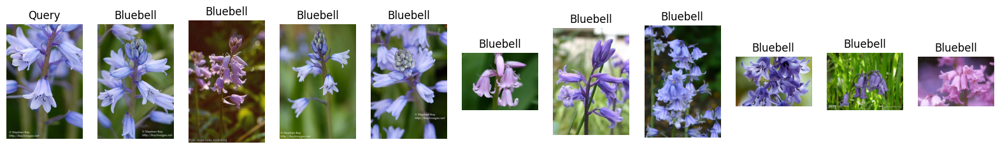

In [66]:
query_path = main_datasets_path + 'Flores_Query/'
image_files = query_path + 'Bluebell/'
fotos = os.listdir(image_files)
query = image_files + fotos[0]
results = last_search(query, finetuning_features_vectors, n_results=10)
print(results)
show_results(query, results, species, species_path)

['image_1144.jpg', 'image_1176.jpg', 'image_1142.jpg', 'image_1173.jpg', 'image_1154.jpg', 'image_1137.jpg', 'image_1162.jpg', 'image_1122.jpg', 'image_1155.jpg', 'image_1156.jpg']


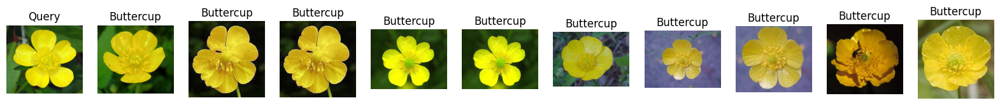

In [67]:
query_path = main_datasets_path + 'Flores_Query/'
image_files = query_path + 'Buttercup/'
fotos = os.listdir(image_files)
query = image_files + fotos[0]
results = last_search(query, finetuning_features_vectors, n_results=10)
print(results)
show_results(query, results, species, species_path)

['image_0803.jpg', 'image_0827.jpg', 'image_0848.jpg', 'image_0828.jpg', 'image_0806.jpg', 'image_0815.jpg', 'image_0866.jpg', 'image_0838.jpg', 'image_0823.jpg', 'image_0850.jpg']


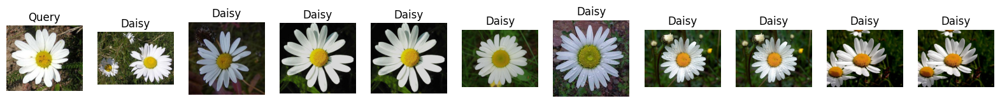

In [68]:
query_path = main_datasets_path + 'Flores_Query/'
image_files = query_path + 'Daisy/'
fotos = os.listdir(image_files)
query = image_files + fotos[0]
results = last_search(query, finetuning_features_vectors, n_results=10)
print(results)
show_results(query, results, species, species_path)

['image_0794.jpg', 'image_0781.jpg', 'image_0736.jpg', 'image_0787.jpg', 'image_0730.jpg', 'image_0747.jpg', 'image_0723.jpg', 'image_0729.jpg', 'image_0773.jpg', 'image_0734.jpg']


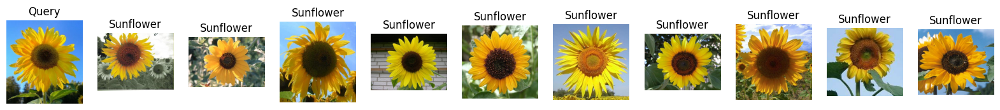

In [69]:
query_path = main_datasets_path + 'Flores_Query/'
image_files = query_path + 'Sunflower/'
fotos = os.listdir(image_files)
query = image_files + fotos[0]
results = last_search(query, finetuning_features_vectors, n_results=10)
print(results)
show_results(query, results, species, species_path)

['image_0564.jpg', 'image_0582.jpg', 'image_0569.jpg', 'image_0572.jpg', 'image_0610.jpg', 'image_0604.jpg', 'image_0616.jpg', 'image_0581.jpg', 'image_0621.jpg', 'image_0580.jpg']


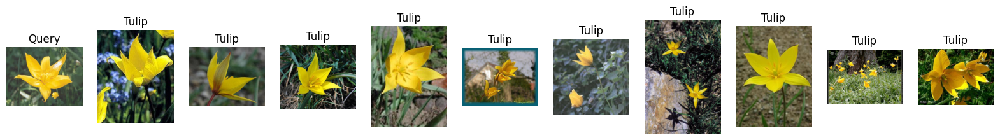

In [70]:
query_path = main_datasets_path + 'Flores_Query/'
image_files = query_path + 'Tulip/'
fotos = os.listdir(image_files)
query = image_files + fotos[0]
results = last_search(query, finetuning_features_vectors, n_results=10)
print(results)
show_results(query, results, species, species_path)

Podemos observar que este modelo predice a la perfección, el tipo de flor, dada la imagen de una cualquiera. Mejora ampliamente las prestaciones del modelo desarrollado en el anterior apartado, puesto que además de las flores más sencillas, también es capaz de diferenciar entre tipos de flores muy parecidos, como el caso de Tulip con Daffodil